<a href="https://colab.research.google.com/github/Claptar/spatialMPFC/blob/main/DE/mammals/ANOVA_zscore/ANOVA_cluster.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dependencies and files

## Install dependencies

In [1]:
!python --version

Python 3.10.11


In [ ]:
!pip install scanpy[leiden]  --quiet

# Необходимо, чтобы конкретно прогрузился matplotlib
import os
os.kill(os.getpid(), 9)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 19.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.0/103.0 kB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 4.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 23.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 9.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 50.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.5/63.5 kB 2.9 MB/s eta 0:00:00


## Imports

In [1]:
import warnings
import scanpy as sc
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os

sc.settings.set_figure_params(dpi=80)
#sc.set_figure_params(facecolor="white", figsize=(8, 8))
warnings.simplefilter(action='ignore', category=FutureWarning)
sc.settings.verbosity = 3

# Global variables

Нужно подключить свой гугл диск

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
dir_path = 'drive/MyDrive/Spatial project/data/'

In [4]:
de_dir_path = 'drive/MyDrive/Spatial project/results/DE/mammals/ANOVA_zscore/'

In [5]:
os.makedirs('sample_data/heatmaps', exist_ok=True)
os.makedirs('sample_data/snakeplots', exist_ok=True)

In [6]:
os.listdir(de_dir_path)

['anova_zscore_mamm.csv',
 'ttest_zscore_mamm.csv',
 'anova_zscore_human_sig_genes.csv',
 'cluster_spectr_anova_6.csv',
 'cluster_spectr_anova_7.csv',
 'cluster_spectr_anova_8.csv',
 'cluster_spectr_anova_9.csv',
 'cluster_spectr_hs_6.csv',
 'cluster_spectr_hs_7.csv',
 'cluster_spectr_hs_8.csv',
 'cluster_spectr_hs_9.csv']

In [7]:
layers = ['WM', 'L1', 'L2', 'L3', 'L4', 'L5', "L6"]
cluster_color = ['red', 'blue', 'green',  'yellow', 'orange', 'purple', 'olive', 'pink', 'brown']
clusters_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I']

### DE results

In [8]:
anova_res = pd.read_csv(de_dir_path + 'anova_zscore_mamm.csv', index_col=0)
anova_genes = anova_res[anova_res.p_val_adj < 0.05].index
anova_res.head()

,sum_sq,df,F,PR(>F),p_val_adj
NOC2L,5.990471,12.0,0.786369,0.662606,0.736513
HES4,15.867262,12.0,1.998201,0.036421,0.089486
AGRN,15.368378,12.0,2.920726,0.002353,0.011859
SDF4,16.021979,12.0,1.833708,0.058172,0.125907
B3GALT6,13.207995,12.0,1.886929,0.050056,0.113088


In [9]:
ttest_res = pd.read_csv(de_dir_path + 'ttest_zscore_mamm.csv', index_col=0)
ttest_res.head()

,gene,layer,group1,group2,score,pvalue,p_val_adj
0,AGRN,L1,human,chimp,0.337496,0.747237,0.874437
1,DVL1,L1,human,chimp,-0.541166,0.607885,0.786700
2,ANKRD65,L1,human,chimp,-0.558791,0.596527,0.779552
3,TMEM240,L1,human,chimp,2.100462,0.080426,0.283097
4,SSU72,L1,human,chimp,-0.306706,0.769432,0.888220


In [10]:
anova_sig_genes = pd.read_csv(de_dir_path + 'anova_zscore_human_sig_genes.csv', index_col=0)
anova_sig_genes.head()

,layer,count,cond
gene,,,
PPCS,L1,2,both
PPM1E,L1,2,both
PPP1R1B,L1,2,both
PRKCA,L1,2,both
REPIN1,L1,2,both


## Load normalized pseudobulks

In [11]:
pb_dir_path = 'drive/MyDrive/Spatial project/data/pseudobulks/'

In [12]:
os.listdir(pb_dir_path)

['expression_chimp.csv',
 'expression_human.csv',
 'expression_macaque.csv',
 'expression_spatial_libd_human.csv',
 'expression_sum_chimp.csv',
 'expression_mean_chimp.csv',
 'annotation_chimp.csv',
 'expression_sum_human.csv',
 'expression_mean_human.csv',
 'annotation_human.csv',
 'expression_sum_macaque.csv',
 'expression_mean_macaque.csv',
 'annotation_macaque.csv',
 'expression_sum_spatial_libd_human.csv',
 'expression_mean_spatial_libd_human.csv',
 'annotation_spatial_libd_human.csv',
 'pb_age_sample_norm.h5ad',
 'pb_mamm.h5ad',
 'pb_age.h5ad',
 'pb_mamm_sample_norm.h5ad',
 'pb_mamm_sample_norm_zscore.h5ad',
 'pb_mamm_sample_norm_filtered.h5ad',
 'pb_mamm_sample_zscore_filtered.h5ad']

In [13]:
adata_pb_norm = sc.read_h5ad(pb_dir_path + 'pb_mamm_sample_zscore_filtered.h5ad')
adata_pb_norm.var = anova_res
adata_pb_norm

AnnData object with n_obs × n_vars = 94 × 9177
    obs: 'layer', 'sample_id', 'condition', 'lib_size', 'log_lib_size'
    var: 'sum_sq', 'df', 'F', 'PR(>F)', 'p_val_adj'
    uns: 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

# Визуализация

## PCA

In [14]:
adata_norm_anova = adata_pb_norm[:, adata_pb_norm.var.p_val_adj < 0.05]
df = pd.DataFrame(adata_norm_anova.X, columns=adata_norm_anova.var_names, index=adata_norm_anova.obs_names)
df.head()

,AGRN,DVL1,ANKRD65,TMEM240,SSU72,NADK,GNB1,GABRD,PRXL2B,TP73,...,BACE2,RSPH1,SLC37A1,NDUFV3,PFKL,COL18A1,COL6A2,LSS,S100B,PRMT2
WM.human_759,-0.587642,-1.286920,-0.576363,-0.380628,-1.240666,-0.392693,-0.483084,1.407974,-1.723192,-0.575693,...,1.663989,-0.853375,0.108966,1.184652,-0.296019,0.451466,-0.369064,0.092059,-0.042967,1.253488
L5.human_759,1.094423,1.414952,-1.222106,0.233035,0.754170,0.448221,-0.064083,-1.209941,1.176506,1.122923,...,-0.193109,-0.151853,-0.479464,0.629778,1.208178,-0.710780,0.304512,-0.169775,-0.537374,-0.526195
L2.human_759,-1.277248,0.964704,0.650609,-1.162999,-0.640948,0.108590,0.628976,-1.415981,0.472657,-0.575693,...,-1.020090,-0.139459,-0.288884,-1.301912,-0.120254,-0.080200,-0.826952,-1.230646,-0.326309,0.483770
L3.human_759,0.756057,0.444693,1.486085,-0.707314,-0.067968,-0.630942,0.897363,0.611384,0.636499,-0.575693,...,-0.588087,0.970978,2.015851,-0.055335,0.083201,-0.594761,-0.448602,-0.094067,-0.521819,-0.858786
L1.human_759,-0.817474,-1.011764,0.533377,-0.439762,-1.006580,-0.664288,-1.988908,0.109069,-0.541418,1.755542,...,-0.323078,-0.830365,-1.163481,-1.423419,-1.496799,2.068523,2.137224,1.874792,2.236604,0.875016


In [15]:
human_specific_genes = anova_sig_genes.index.unique().tolist()
df_hs = df[human_specific_genes].copy()
df_hs.head()

,PPCS,PPM1E,PPP1R1B,PRKCA,REPIN1,RPRM,NINL,NPPC,SLAIN1,SLC30A4,...,IGSF8,IGDCC3,IFNAR1,IFI44,IFI27,HTR2A,HSPB11,HRH2,CAMLG,ZSWIM7
WM.human_759,0.758167,-0.044925,1.987225,-1.016848,0.147048,0.565603,0.159591,1.708482,-0.740901,0.415486,...,-0.019305,-1.306454,1.484552,-1.074552,0.671084,0.984603,-0.675700,1.115441,-1.477980,0.436440
L5.human_759,0.792022,0.591107,0.364506,-0.903084,0.220048,0.552304,-1.560128,-0.209226,-0.486566,-0.631171,...,0.071161,-0.609942,-0.754901,-0.080877,-0.381335,-0.182863,0.801984,1.219482,0.295841,0.935502
L2.human_759,0.197307,-0.588779,-0.675648,1.326314,-0.813400,-0.743637,1.429792,-0.874796,1.081883,-0.320239,...,0.988549,0.939727,0.150750,-0.402253,-0.244234,-0.159452,0.773721,-1.319715,0.543590,0.561937
L3.human_759,0.753818,0.038780,-1.014397,0.368848,-1.032592,-0.302683,0.018937,0.326644,-0.329049,1.316753,...,0.734693,-0.356389,-1.451934,-0.405274,-0.678614,-0.478241,1.233555,-0.220045,-0.065385,-0.068487
L1.human_759,-2.000640,-1.541265,-0.214106,1.262392,1.814400,-1.635926,0.960077,0.601793,1.725269,-1.112025,...,-2.098187,1.580345,0.652995,2.002068,1.941515,1.004002,-0.644703,-1.184386,-1.240144,-0.453441


In [16]:
sample_order = dict()
for cond in ['human', 'chimp', 'macaque']:
    samples = df.loc[df.index.str.contains(cond)].index
    order = samples.sort_values()
    order_laminar = order[order.str.contains('L')].tolist()
    order_wm = order[order.str.contains('WM')].tolist()
    sample_order[cond] = order_wm + order_laminar
sample_order['all'] = sample_order['human'] + sample_order['chimp'] + sample_order['macaque']
df = df.loc[sample_order['all']]
df_hs = df_hs.loc[sample_order['all']]

In [17]:
import plotly.express as px
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
components = pca.fit_transform(adata_pb_norm.X.T)

In [18]:
fig = px.scatter(components, x=0, y=1, hover_name=adata_pb_norm.var_names, color=(adata_pb_norm.var.p_val_adj < 0.05))
fig.show()

# Кластеризация всех генов значимых по анове

## Иерархическая кластеризация

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



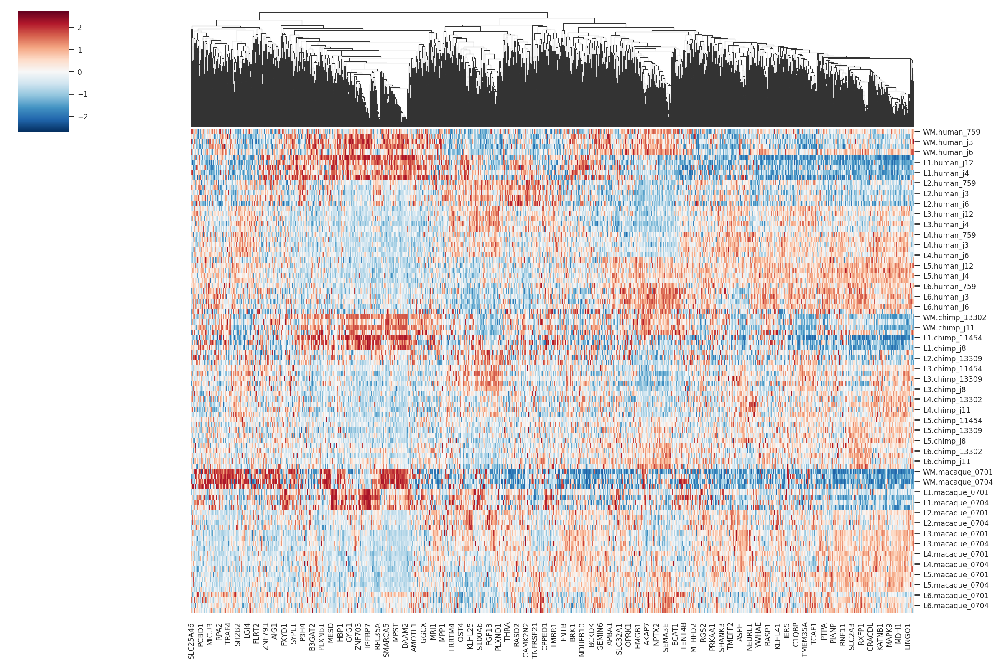

In [19]:
sns.set(font_scale=0.7)
sns.clustermap(df, figsize=(15, 10), cmap="RdBu_r", center=0, vmax=2.7, vmin=-2.7, metric='cosine', annot_kws={"size": 2}, row_cluster=False).savefig('sample_data/heatmaps/clustermap_anova.png')

Сделаем кластеризацию по слоям

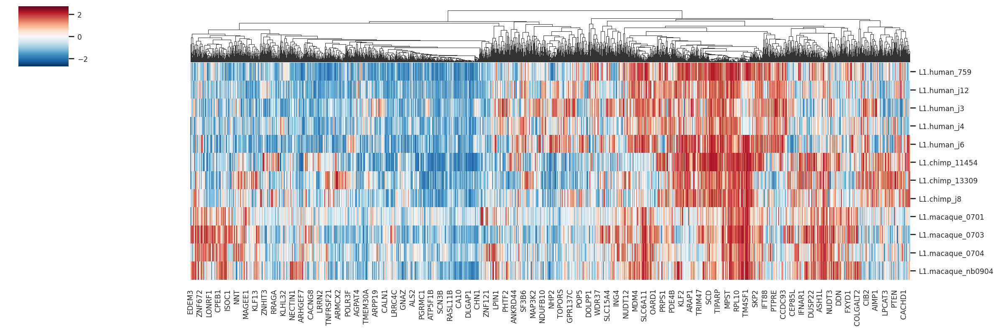

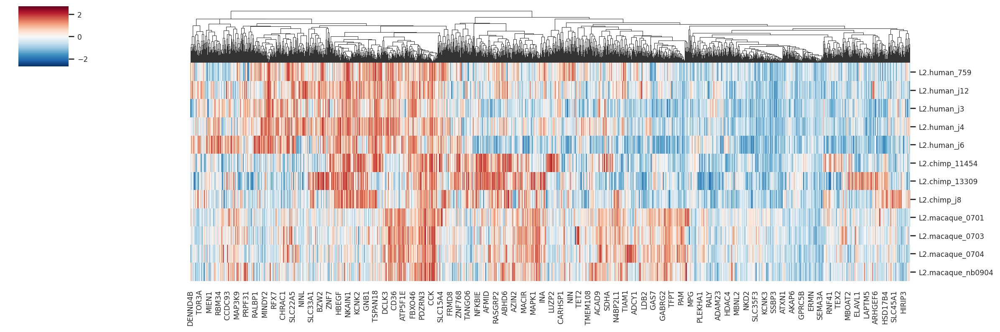

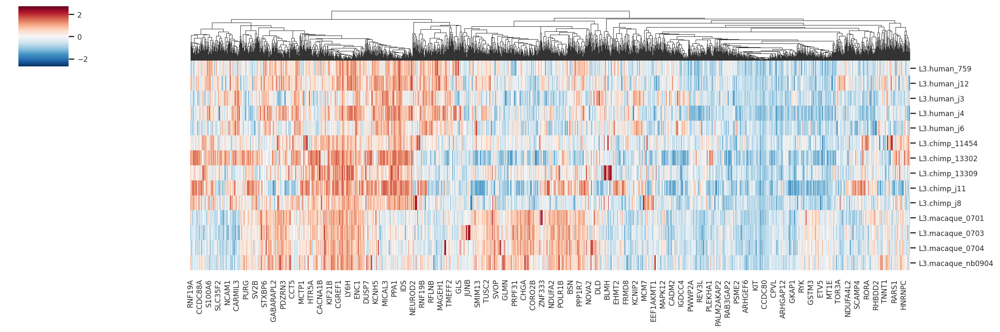

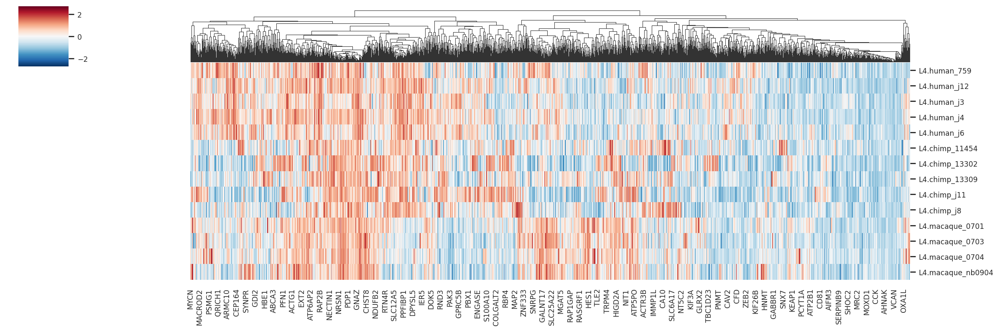

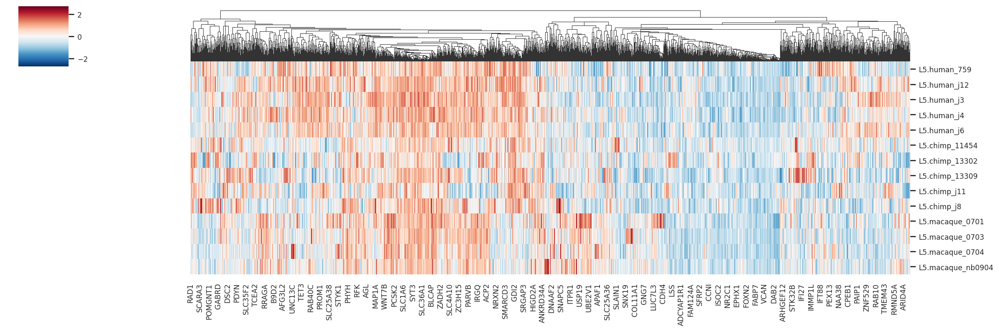

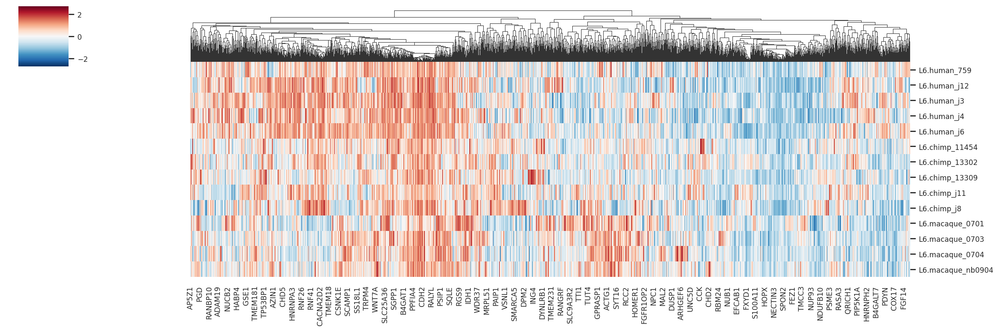

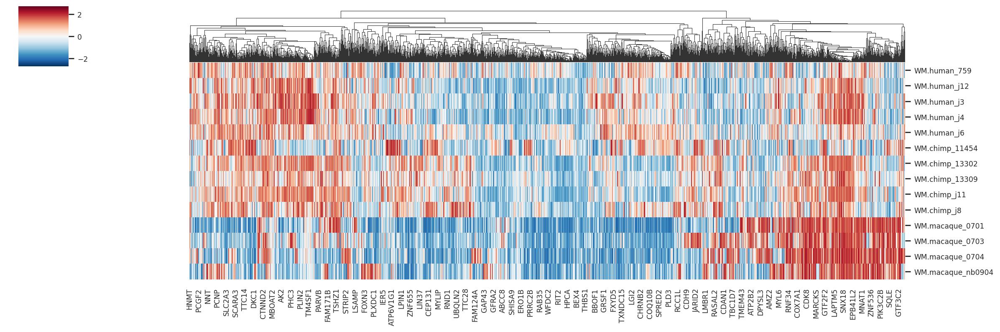

In [20]:
for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    df_layer = df.loc[df.index.str.contains(layer)]
    sns.clustermap(df_layer, figsize=(15, 5), cmap="RdBu_r", center=0,
                   vmax=2.7, vmin=-2.7, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'sample_data/heatmaps/clustermap_anova_{layer}.png')

Сделаем кластеризацию по видам

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



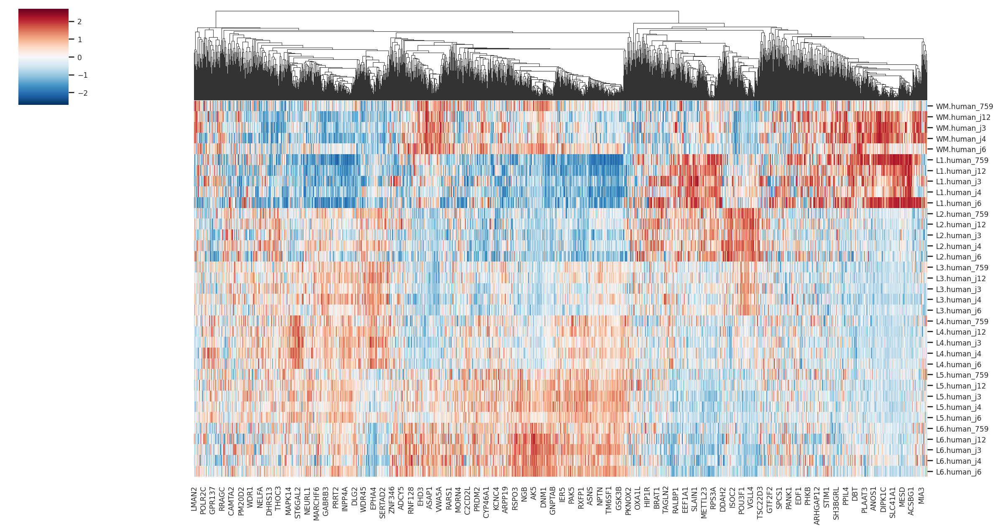

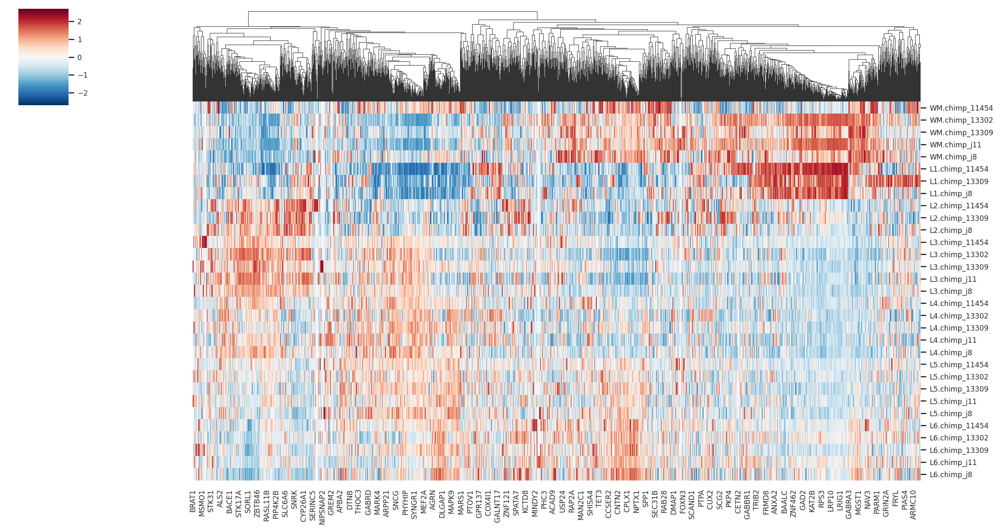

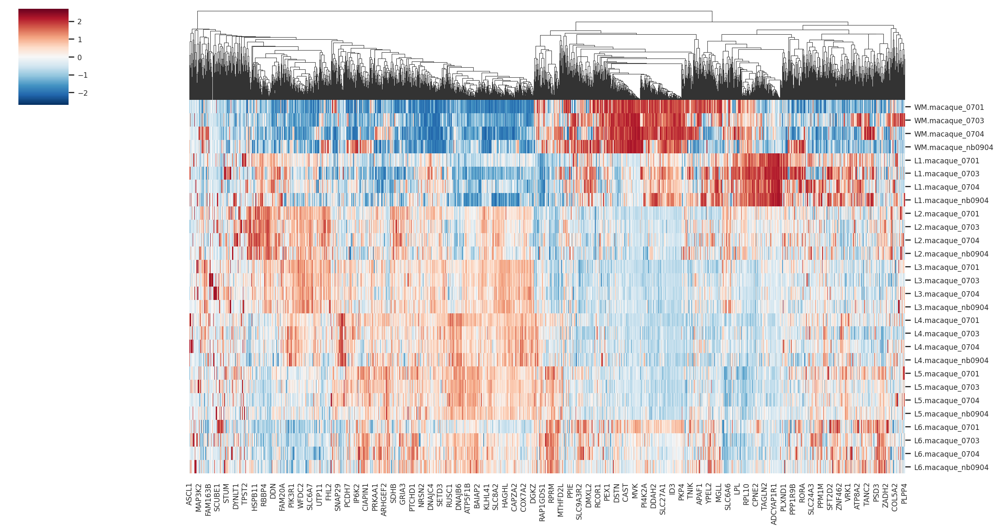

In [21]:
for cond in ['human', 'chimp', 'macaque']:
    df_cond = df.loc[df.index.str.contains(cond)]
    max_val = df_cond.max(axis=0).sort_values()
    df_cond = df_cond[max_val[max_val > 0].index.tolist()]
    sns.clustermap(df_cond, figsize=(15, 8), cmap="RdBu_r", center=0,
                   vmax=2.7, vmin=-2.7, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'sample_data/heatmaps/clustermap_anova_{cond}.png')

## Cпектральная кластеризация

### 6 кластеров

In [22]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df.T, metric='cosine') + 1
n_clusters = 6
clustering = SpectralClustering(n_clusters=n_clusters, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1, n_clusters=6)

In [23]:
labels = pd.Series(clustering.labels_, index=df.columns).sort_values()
order = labels.sort_values().index
labels.to_csv(de_dir_path + f'cluster_spectr_anova_{n_clusters}.csv')

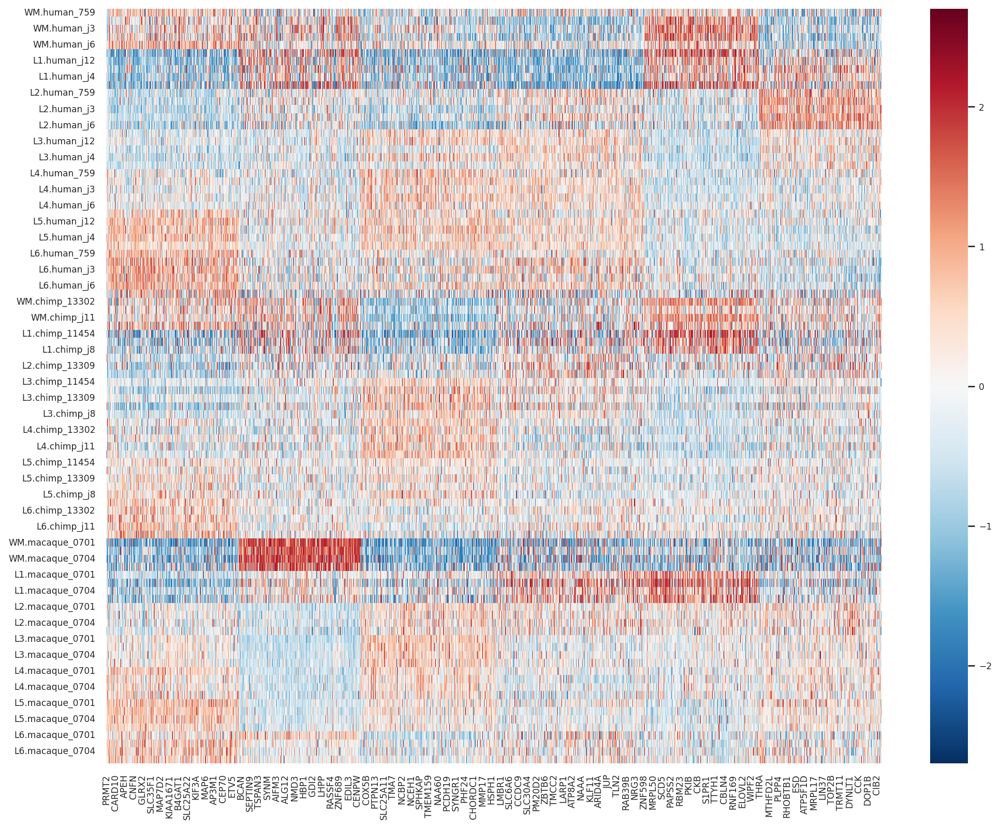

In [24]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova.png', bbox_inches='tight')

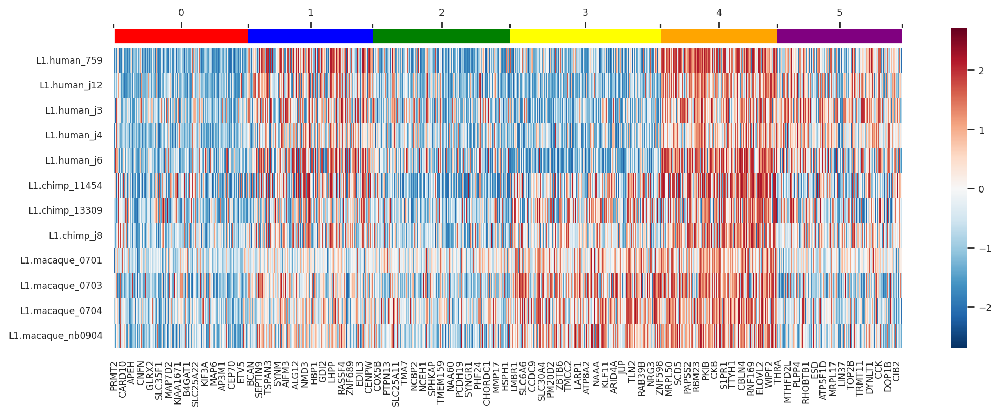

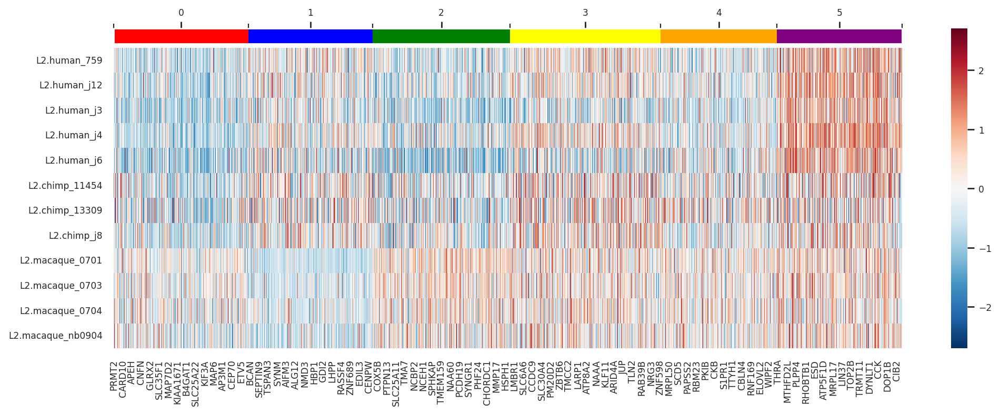

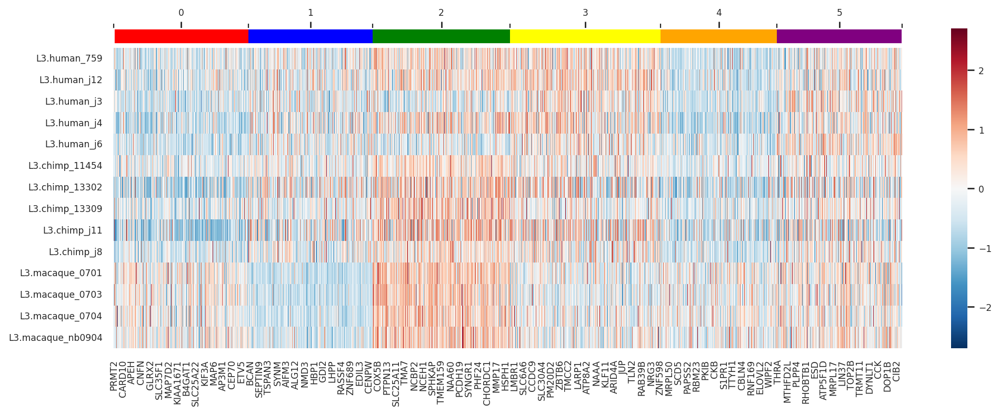

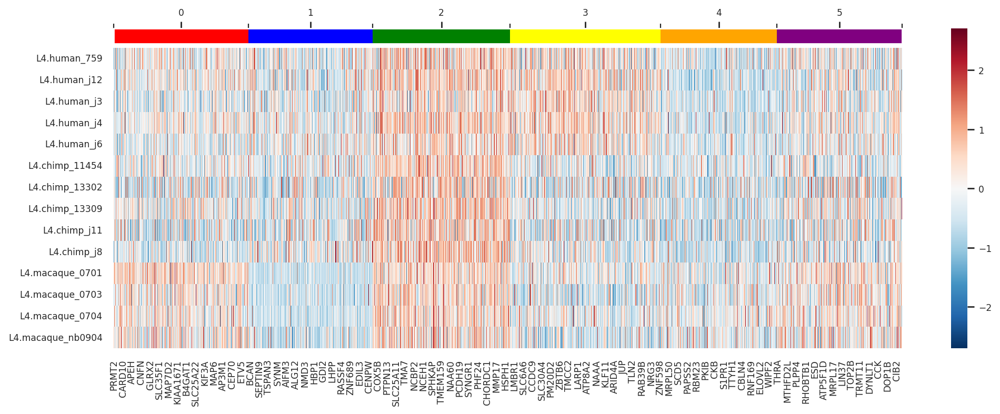

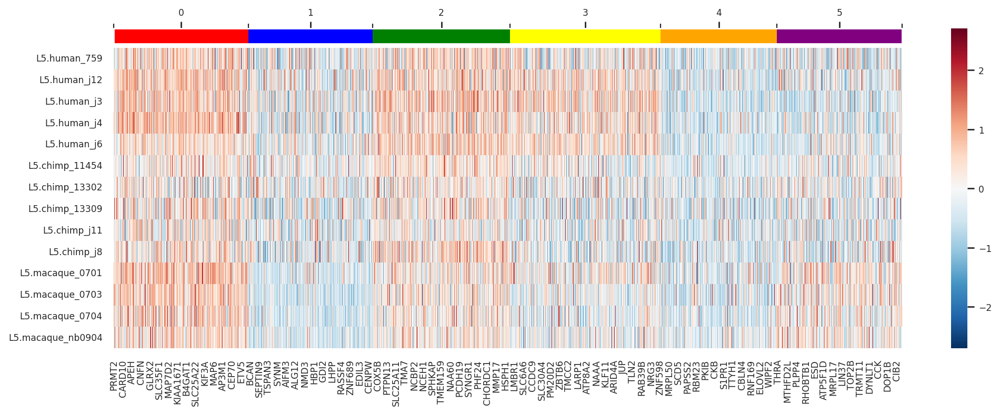

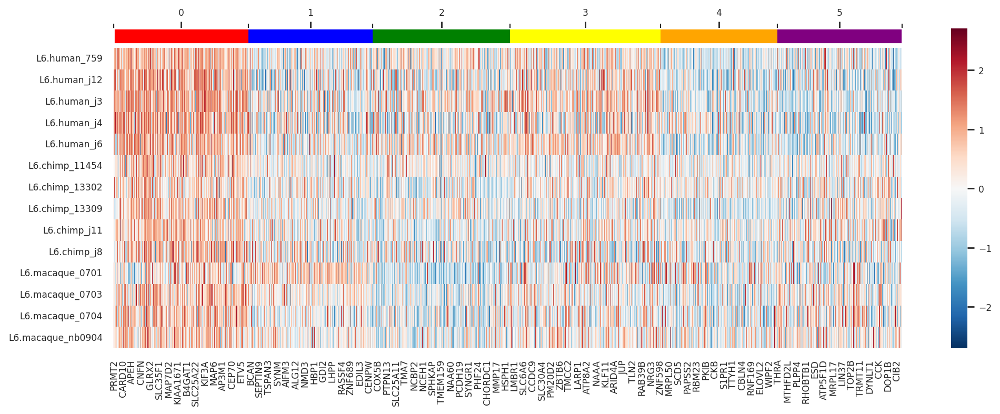

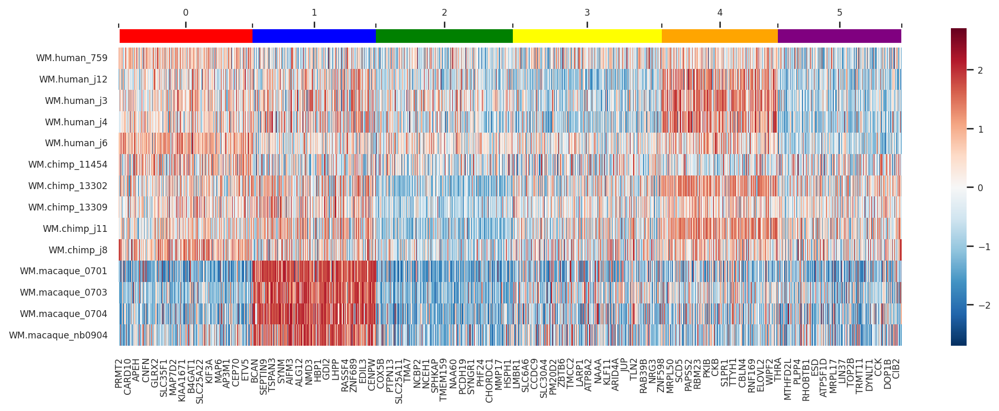

In [25]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]

for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    fig, ax = plt.subplots(figsize=(15, 5), gridspec_kw={'hspace': 0})
    df_layer = df.loc[df.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
    #plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova_{layer}.png', bbox_inches='tight')

<Axes: >

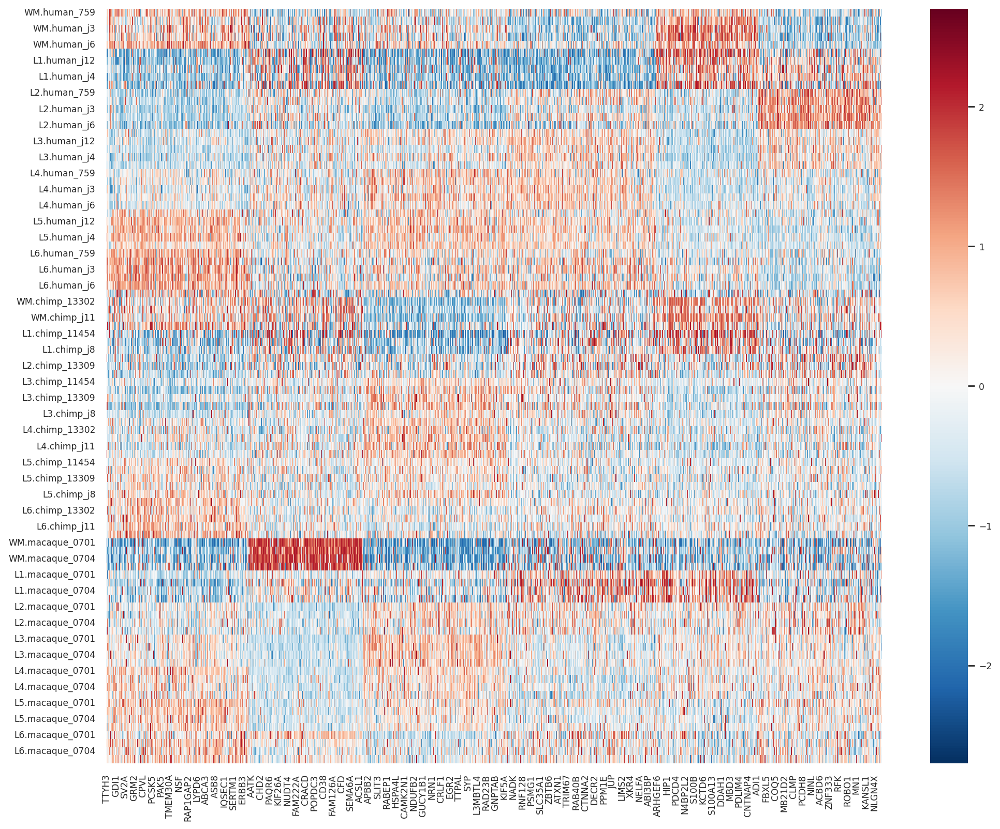

In [26]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))

order_hs = order & df_hs.columns
sns.heatmap(df_hs.loc[sample_order['all'], order_hs], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)

### 7 кластеров

In [27]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df.T, metric='cosine') + 1
n_clusters = 7
clustering = SpectralClustering(n_clusters=n_clusters, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1, n_clusters=7)

In [28]:
labels = pd.Series(clustering.labels_, index=df.columns).sort_values()
order = labels.sort_values().index
labels.to_csv(de_dir_path + f'cluster_spectr_anova_{n_clusters}.csv')

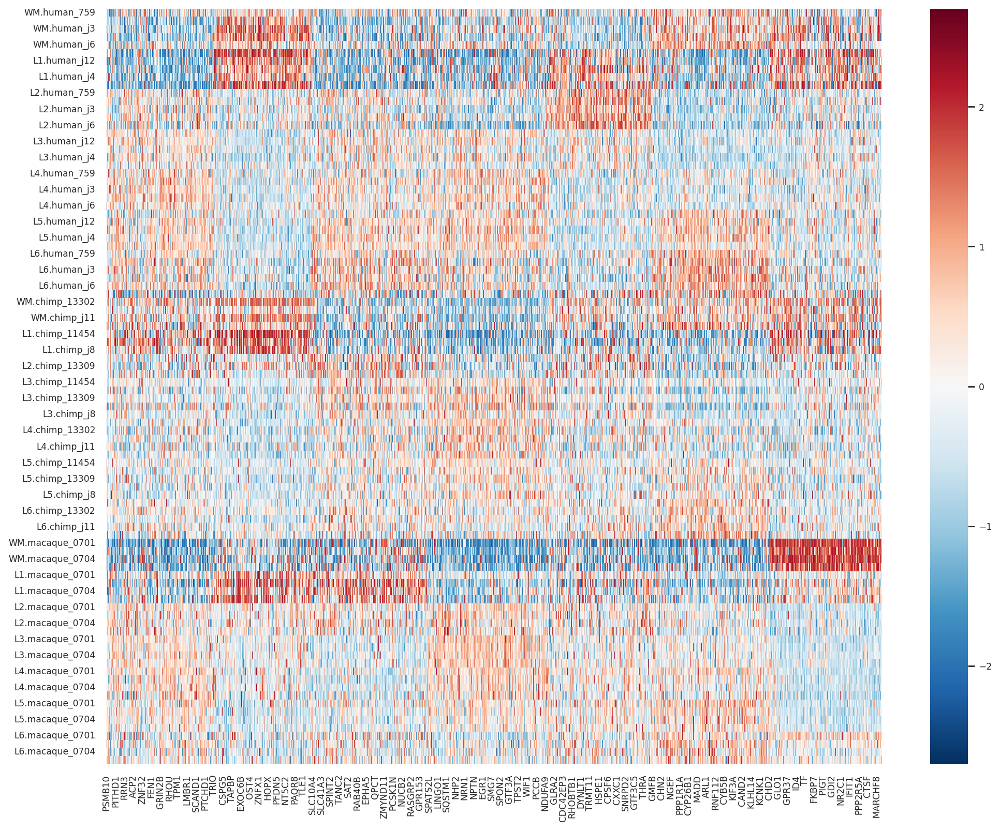

In [29]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova.png', bbox_inches='tight')

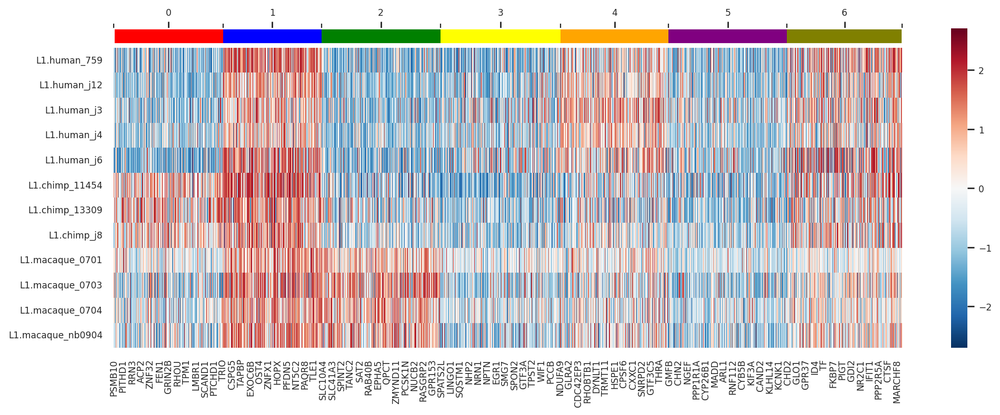

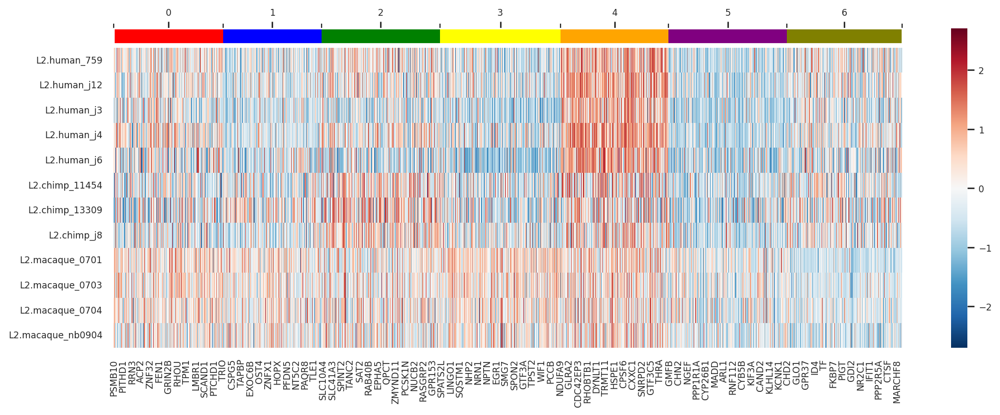

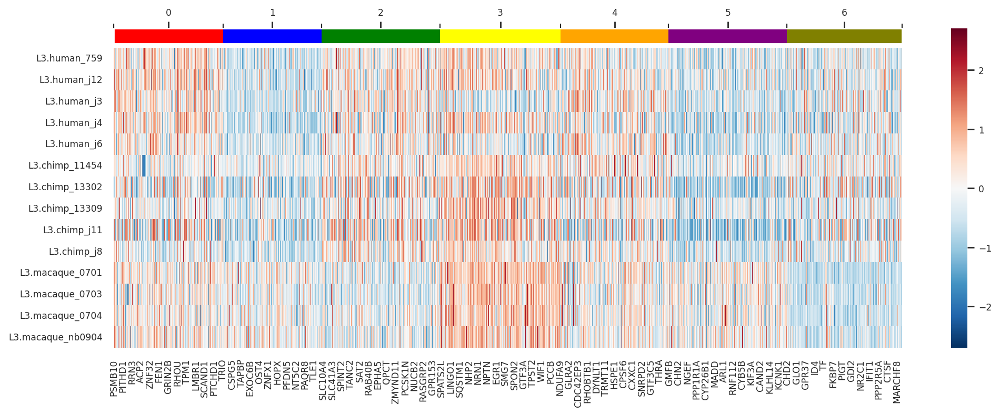

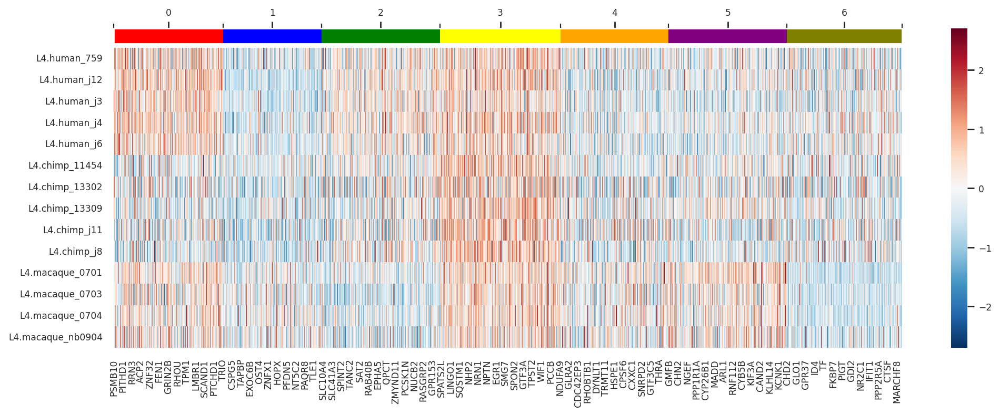

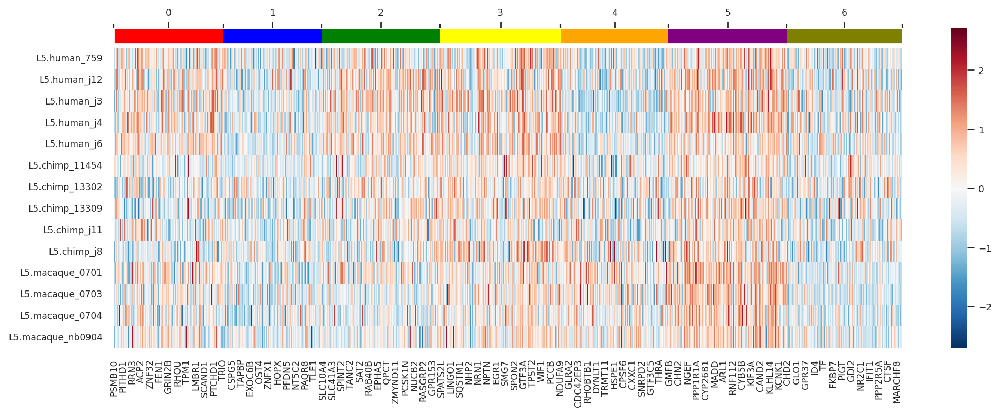

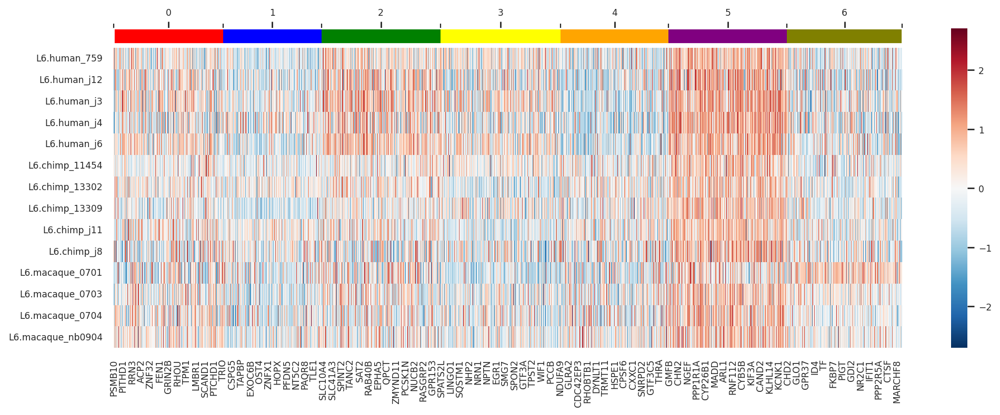

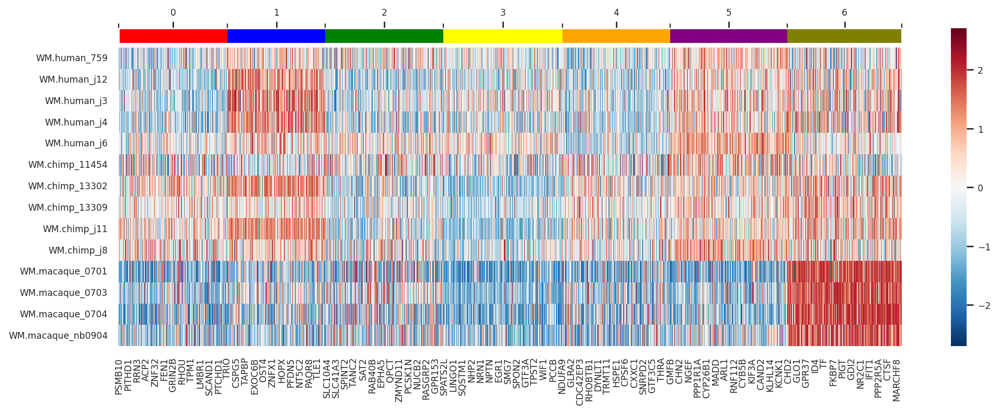

In [30]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]

for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    fig, ax = plt.subplots(figsize=(15, 5), gridspec_kw={'hspace': 0})
    df_layer = df.loc[df.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
    #plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova_{layer}.png', bbox_inches='tight')

<Axes: >

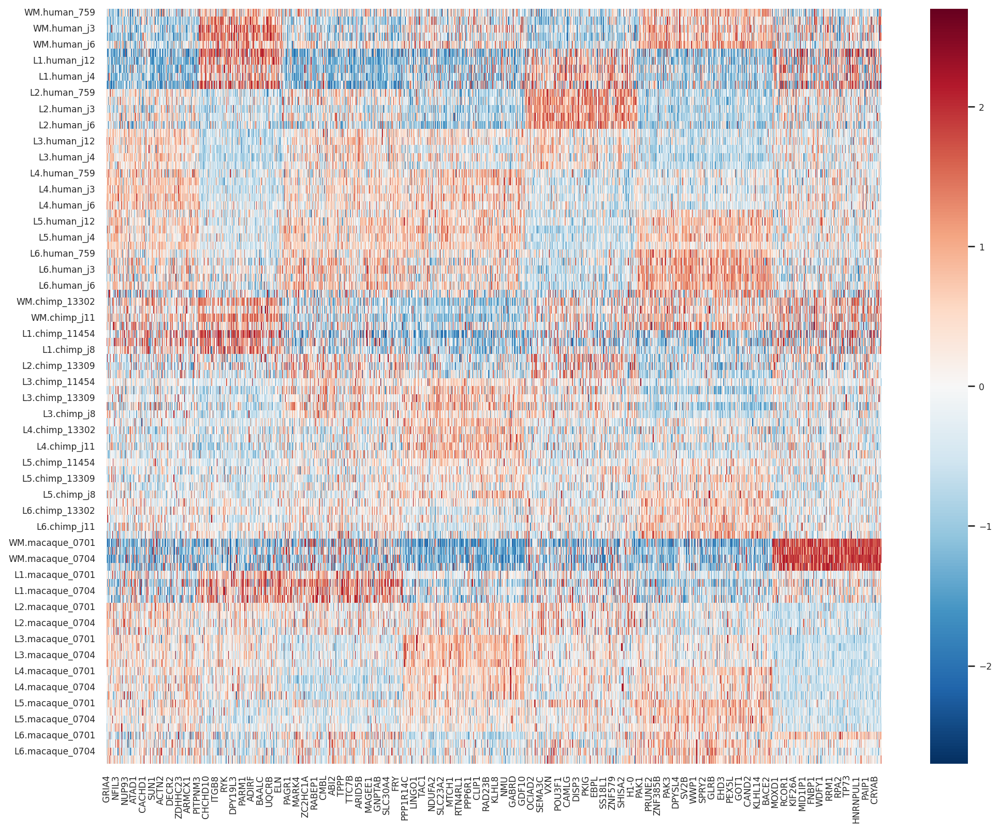

In [31]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))

order_hs = order & df_hs.columns
sns.heatmap(df_hs.loc[sample_order['all'], order_hs], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)

### 8 кластеров

In [32]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df.T, metric='cosine') + 1
n_clusters = 8
clustering = SpectralClustering(n_clusters=n_clusters, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1)

In [33]:
labels = pd.Series(clustering.labels_, index=df.columns).sort_values()
order = labels.sort_values().index
labels.to_csv(de_dir_path + f'cluster_spectr_anova_{n_clusters}.csv')

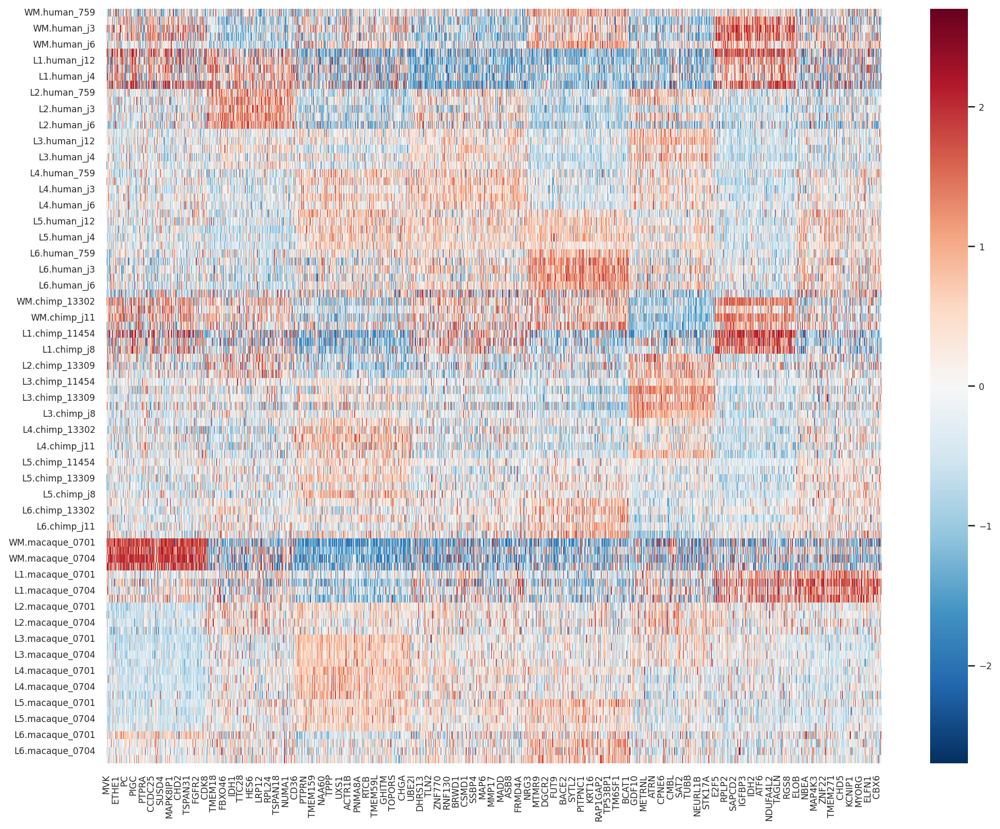

In [34]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova.png', bbox_inches='tight')

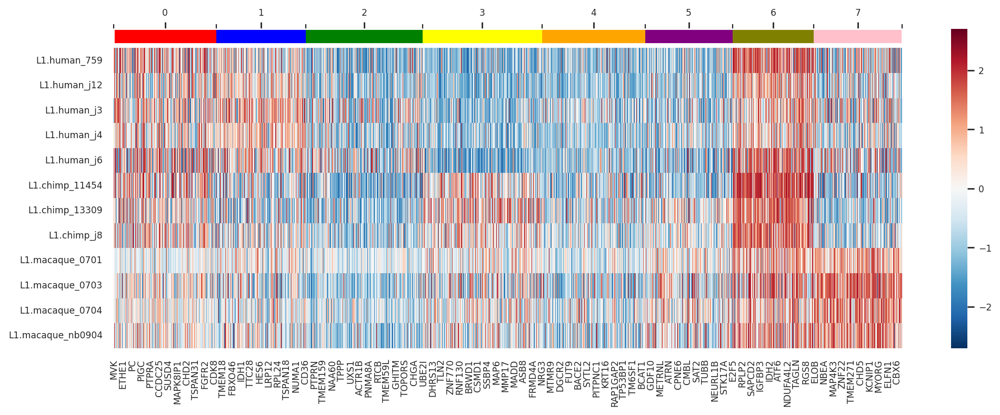

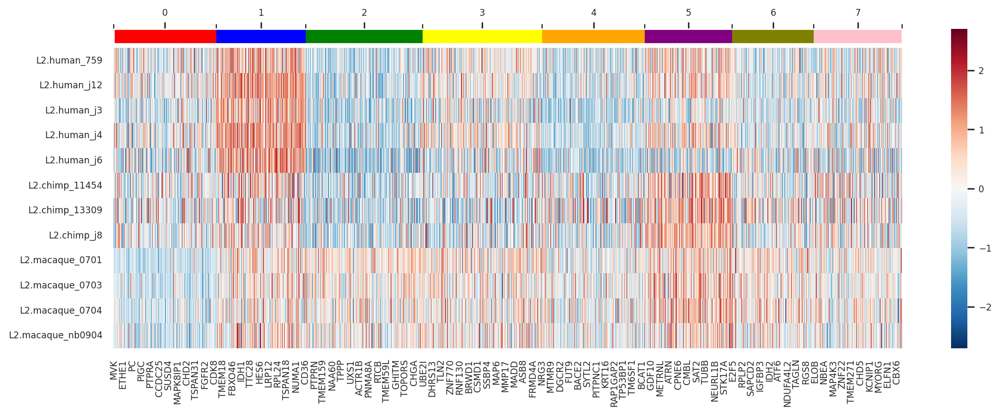

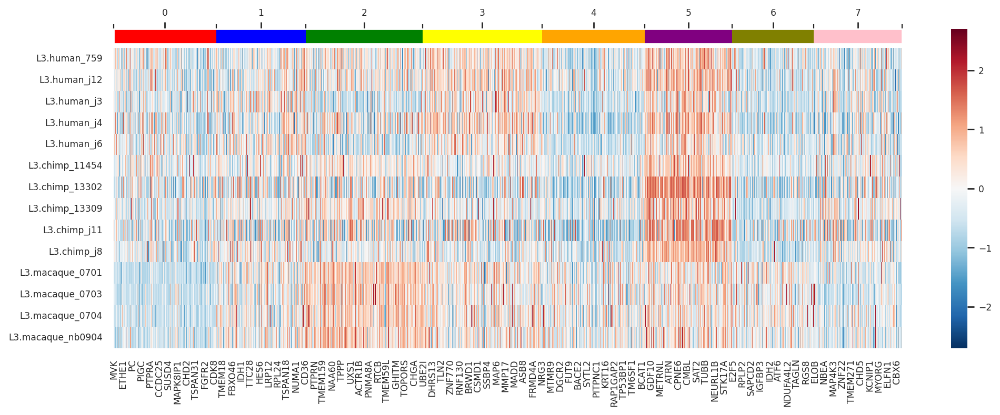

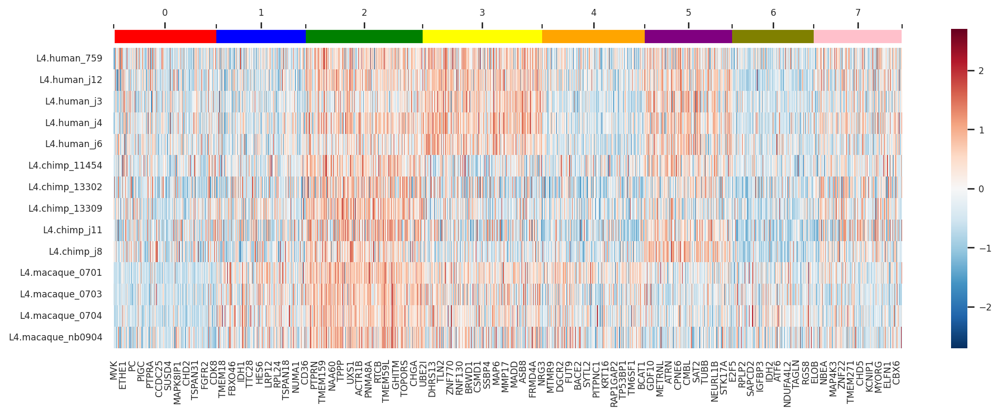

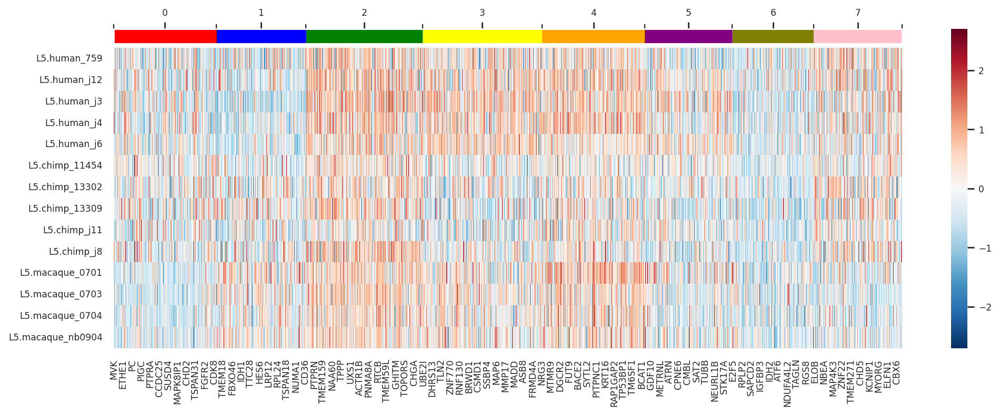

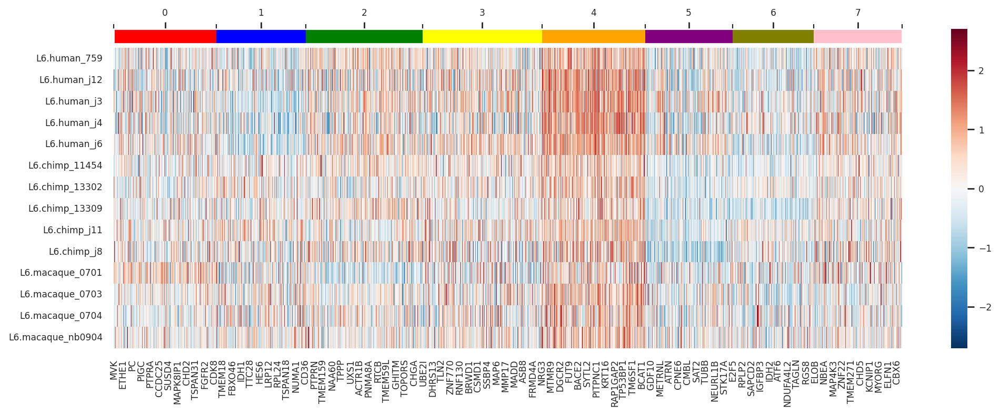

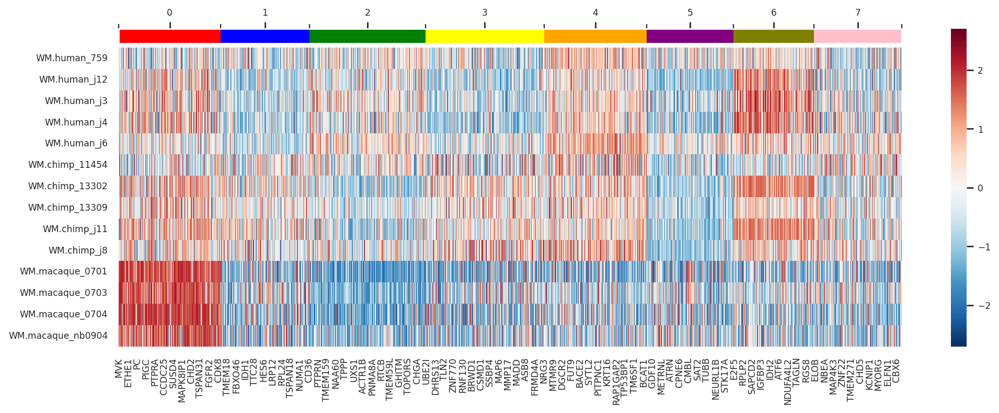

In [35]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]

for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    fig, ax = plt.subplots(figsize=(15, 5), gridspec_kw={'hspace': 0})
    df_layer = df.loc[df.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
    #plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova_{layer}.png', bbox_inches='tight')

<Axes: >

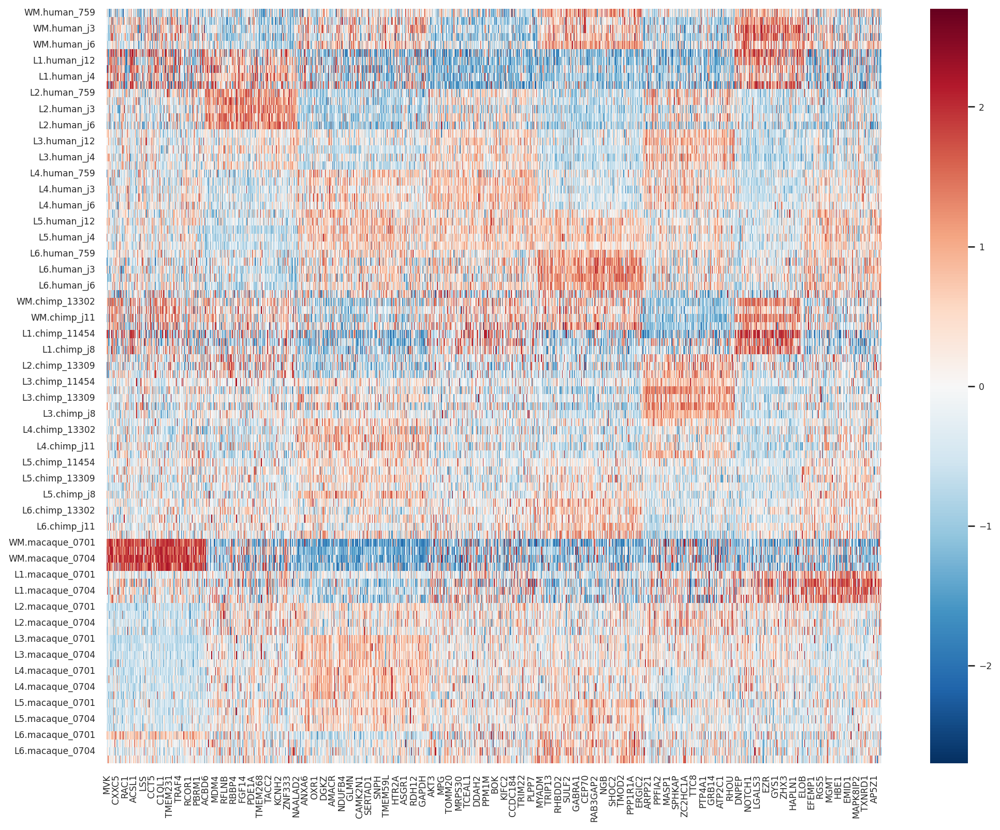

In [36]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))

order_hs = order & df_hs.columns
sns.heatmap(df_hs.loc[sample_order['all'], order_hs], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)

### 9 кластеров

In [37]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df.T, metric='cosine') + 1
n_clusters = 9
clustering = SpectralClustering(n_clusters=n_clusters, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1, n_clusters=9)

In [38]:
labels = pd.Series(clustering.labels_, index=df.columns).sort_values()
order = labels.sort_values().index
labels.to_csv(de_dir_path + f'cluster_spectr_anova_{n_clusters}.csv')

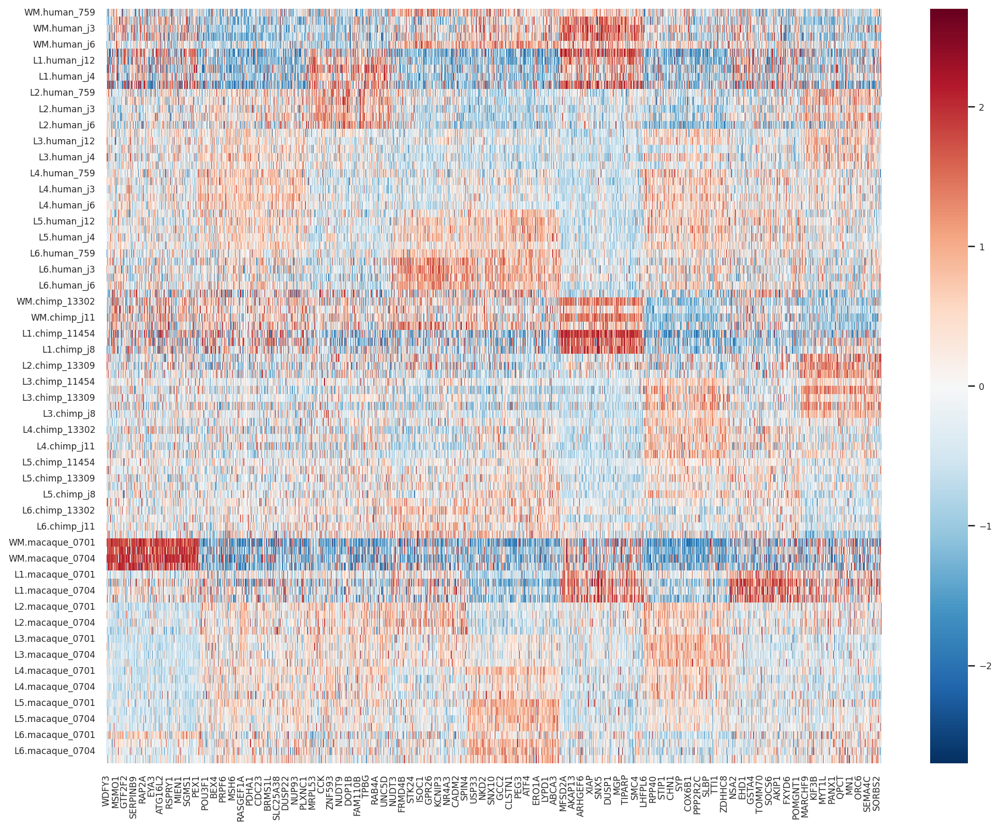

In [39]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova.png', bbox_inches='tight')

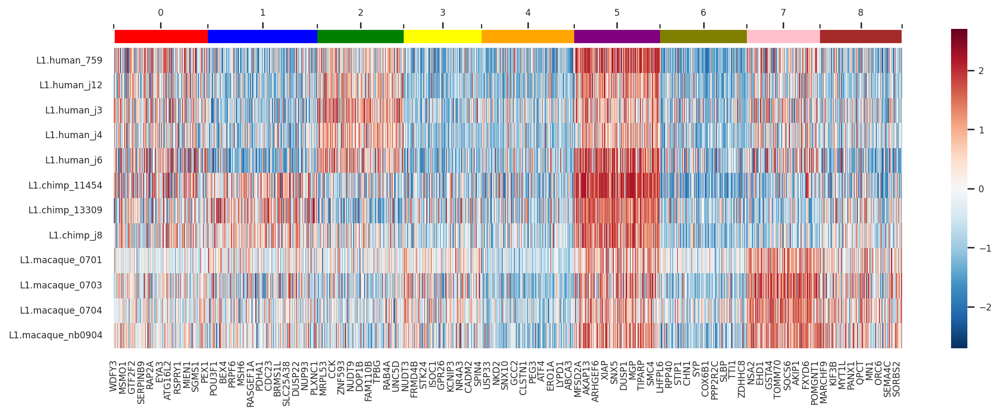

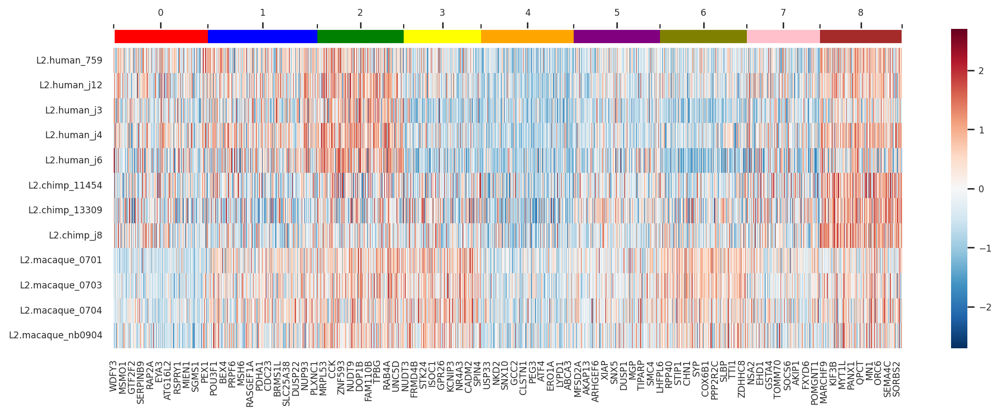

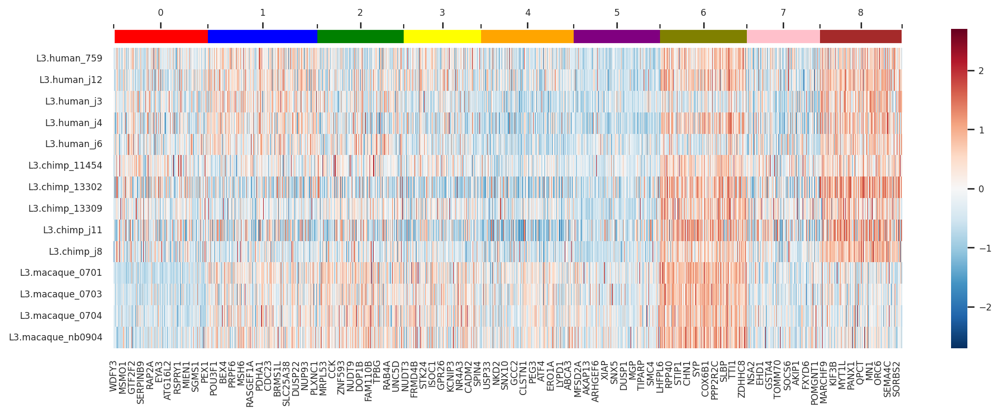

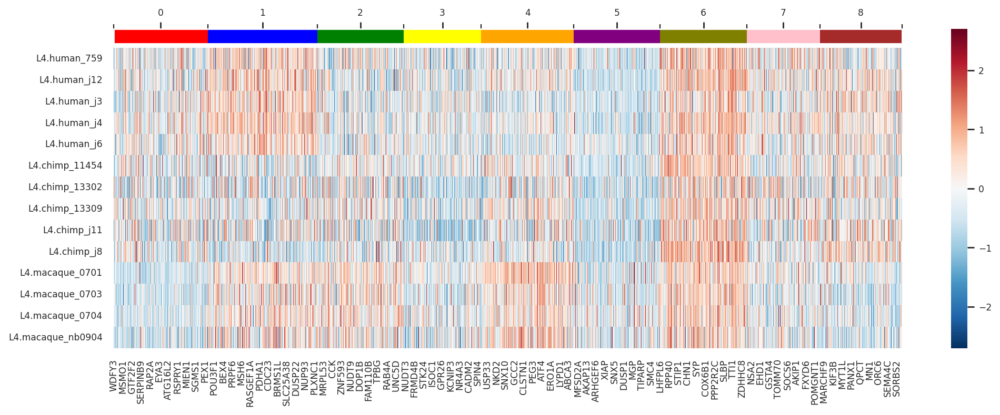

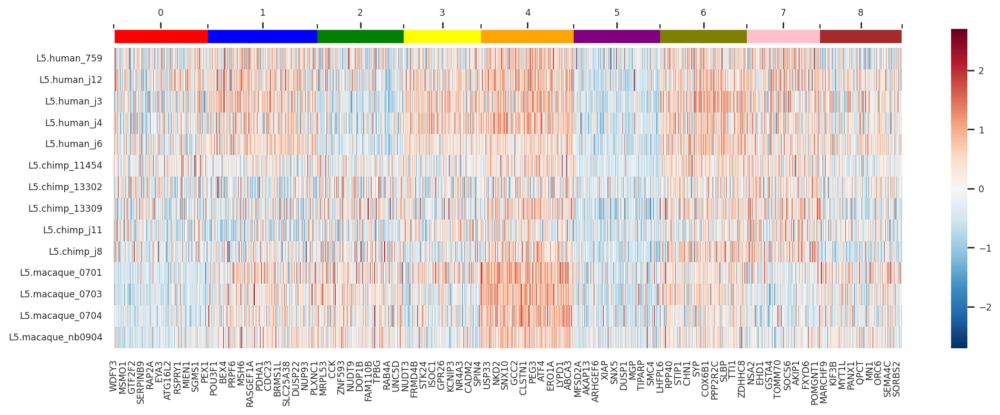

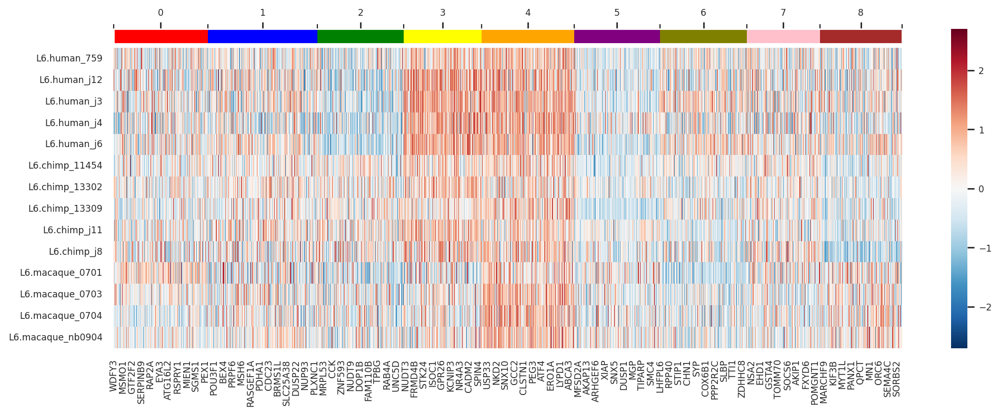

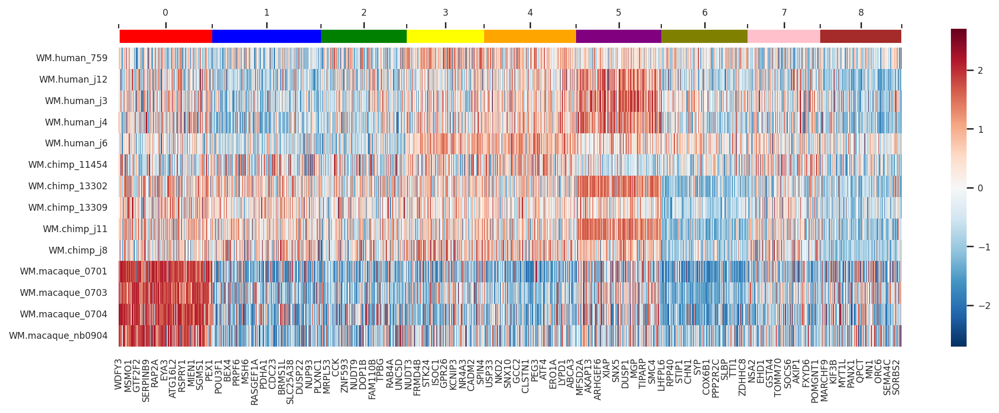

In [40]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]

for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    fig, ax = plt.subplots(figsize=(15, 5), gridspec_kw={'hspace': 0})
    df_layer = df.loc[df.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
    #plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova_{layer}.png', bbox_inches='tight')

<Axes: >

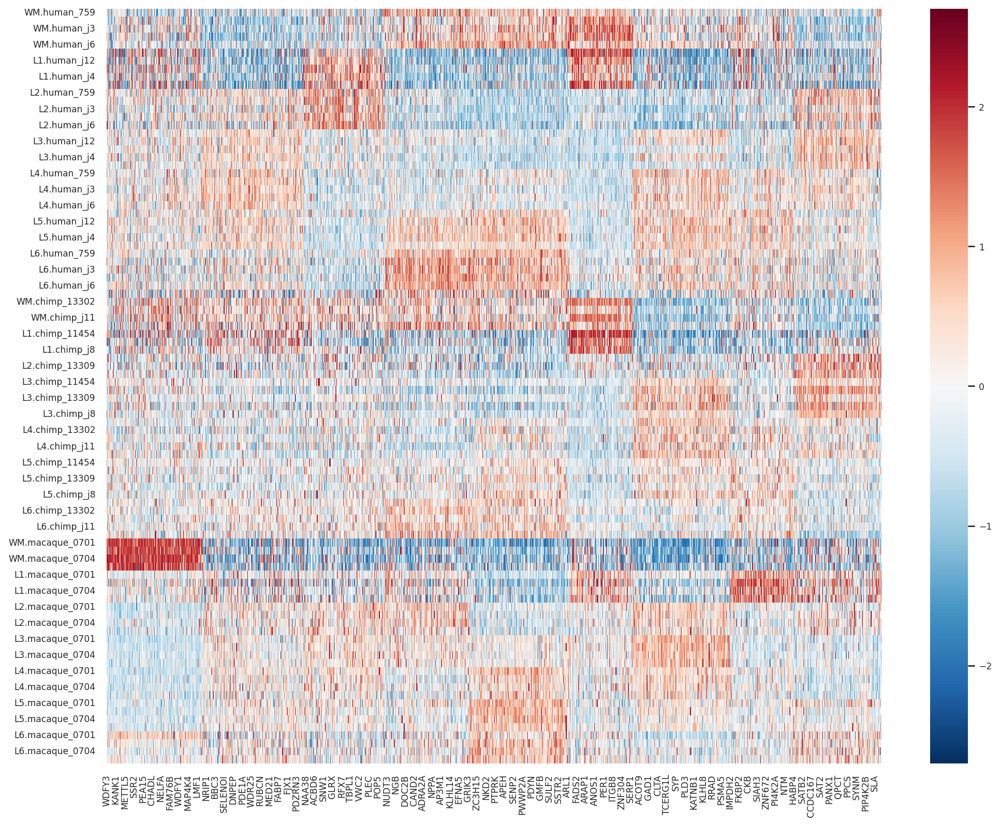

In [41]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))

order_hs = order & df_hs.columns
sns.heatmap(df_hs.loc[sample_order['all'], order_hs], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)

# Кластеризация генов значимых для человека по ttest

## Иерархическая кластеризация

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



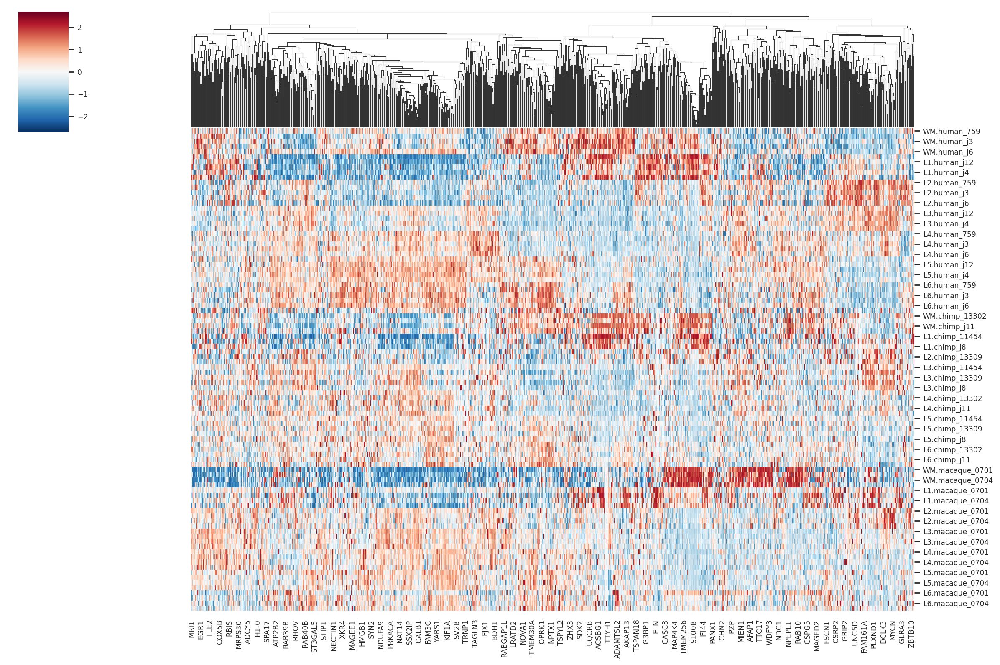

In [42]:
sns.set(font_scale=0.7)
sns.clustermap(df_hs, figsize=(15, 10), cmap="RdBu_r", center=0, vmax=2.7, vmin=-2.7, metric='cosine', annot_kws={"size": 2}, row_cluster=False).savefig('sample_data/heatmaps/clustermap_hs.png')

Сделаем кластеризацию по слоям

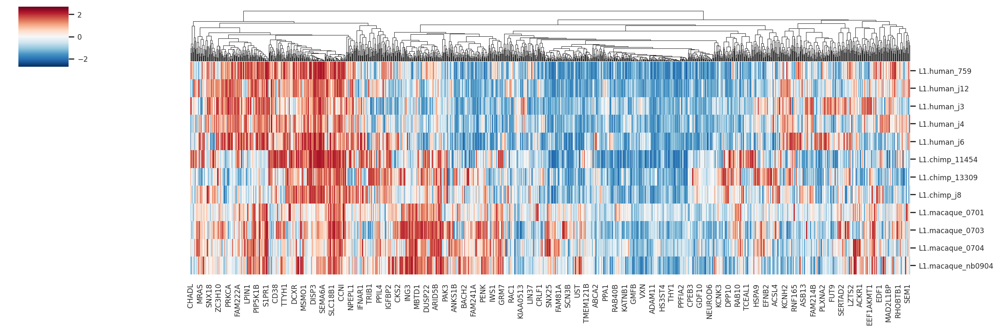

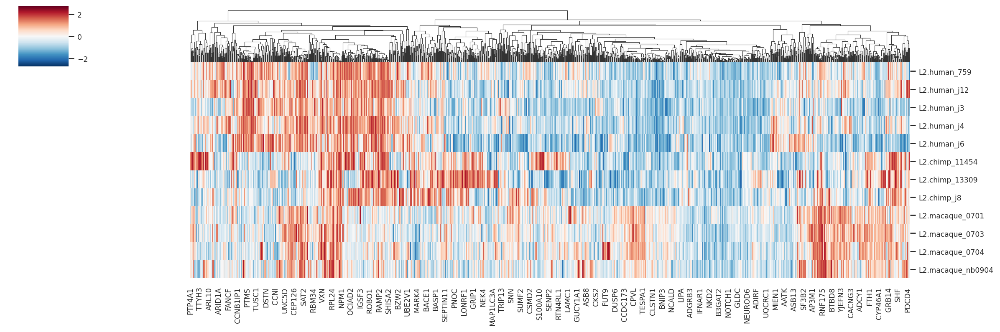

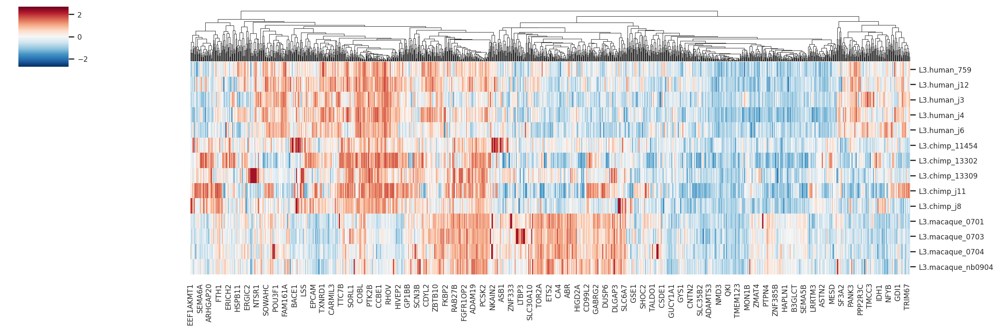

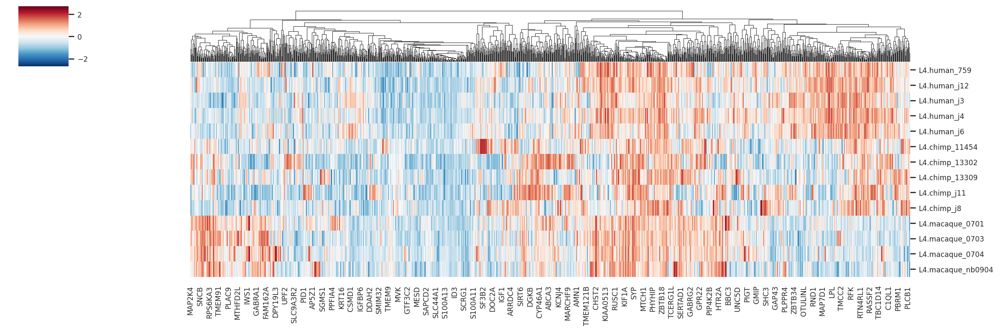

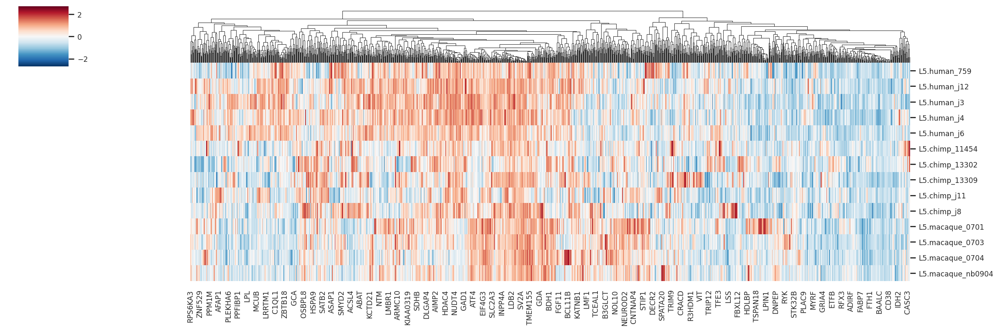

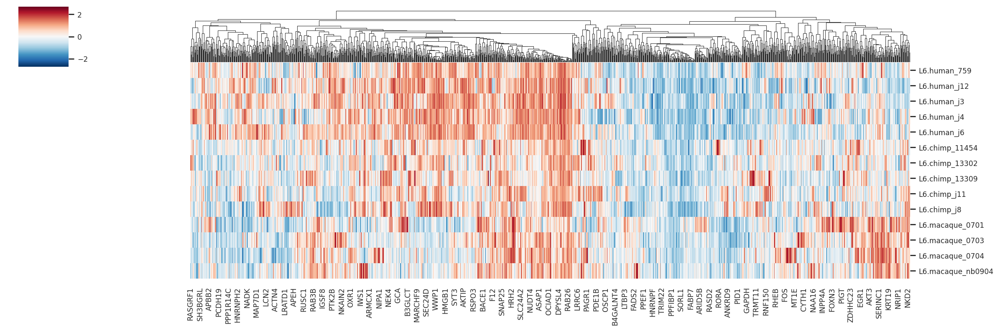

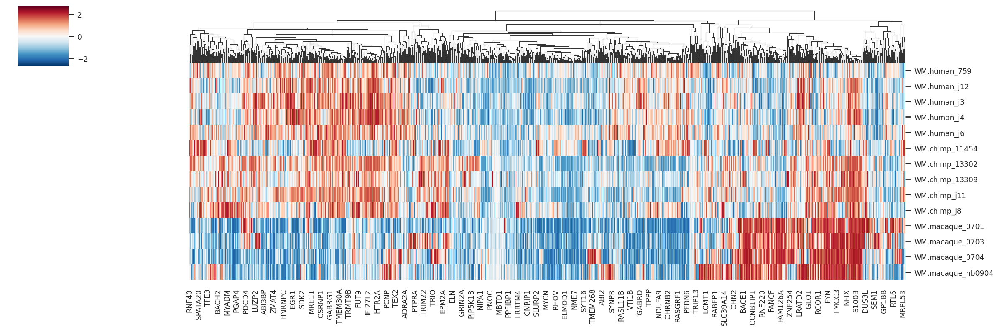

In [43]:
for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    df_layer = df_hs.loc[df.index.str.contains(layer)]
    sns.clustermap(df_layer, figsize=(15, 5), cmap="RdBu_r", center=0,
                   vmax=2.7, vmin=-2.7, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'sample_data/heatmaps/clustermap_hs_{layer}.png')

Сделаем кластеризацию по видам

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



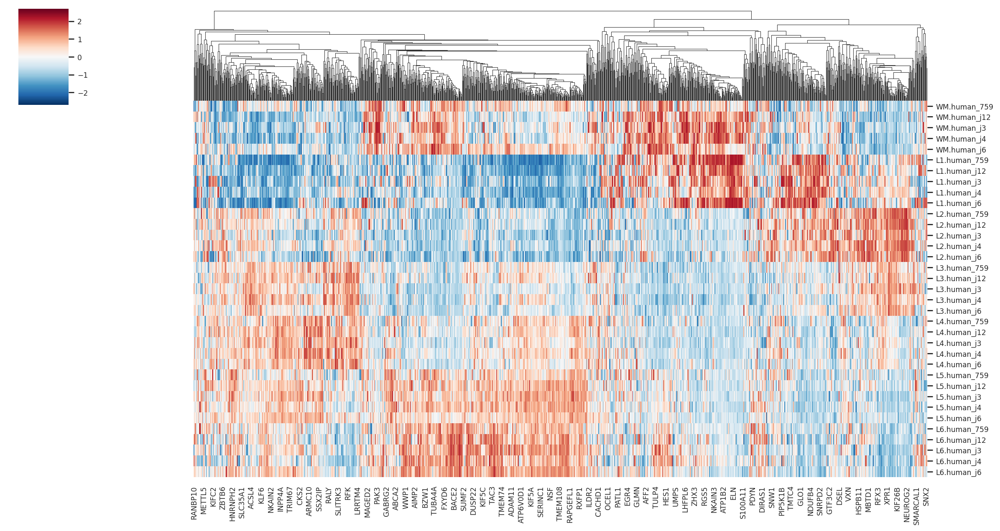

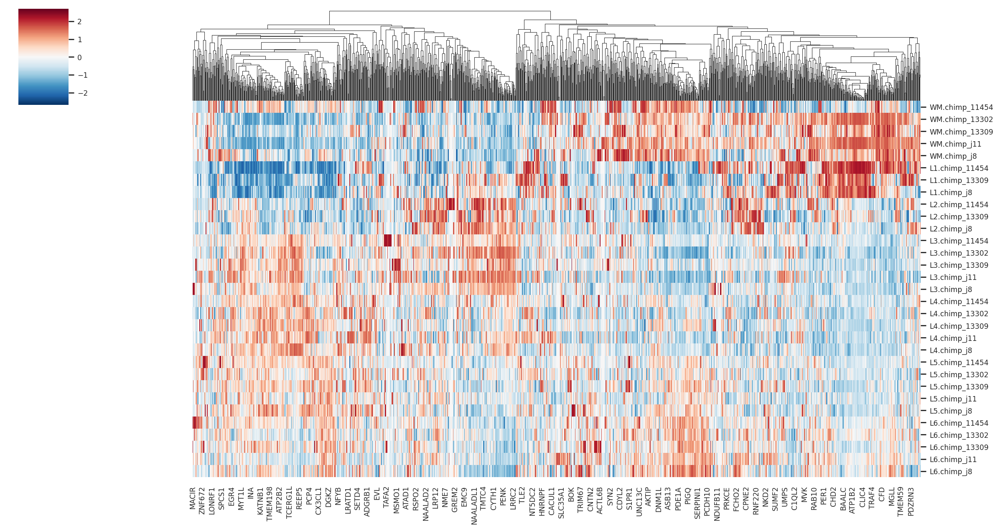

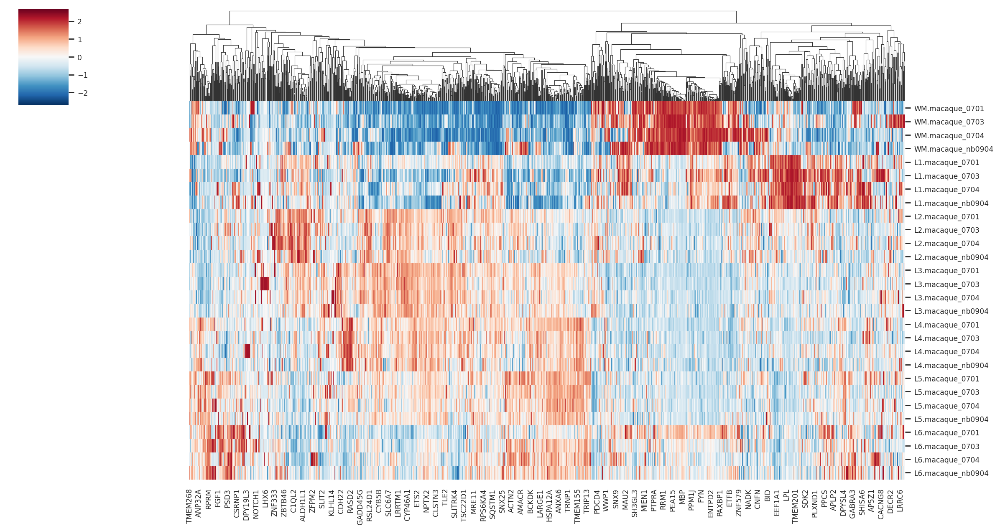

In [44]:
for cond in ['human', 'chimp', 'macaque']:
    df_cond = df_hs.loc[df.index.str.contains(cond)]
    max_val = df_cond.max(axis=0).sort_values()
    df_cond = df_cond[max_val[max_val > 0].index.tolist()]
    sns.clustermap(df_cond, figsize=(15, 8), cmap="RdBu_r", center=0,
                   vmax=2.7, vmin=-2.7, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'sample_data/heatmaps/clustermap_hs_{cond}.png')

## Cпектральная кластеризация

### 6 кластеров

In [45]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df_hs.T, metric='cosine') + 1
n_clusters = 6
clustering = SpectralClustering(n_clusters=n_clusters, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1, n_clusters=6)

In [46]:
labels = pd.Series(clustering.labels_, index=df_hs.columns).sort_values()
order = labels.sort_values().index
labels.to_csv(de_dir_path + f'cluster_spectr_hs_{n_clusters}.csv')

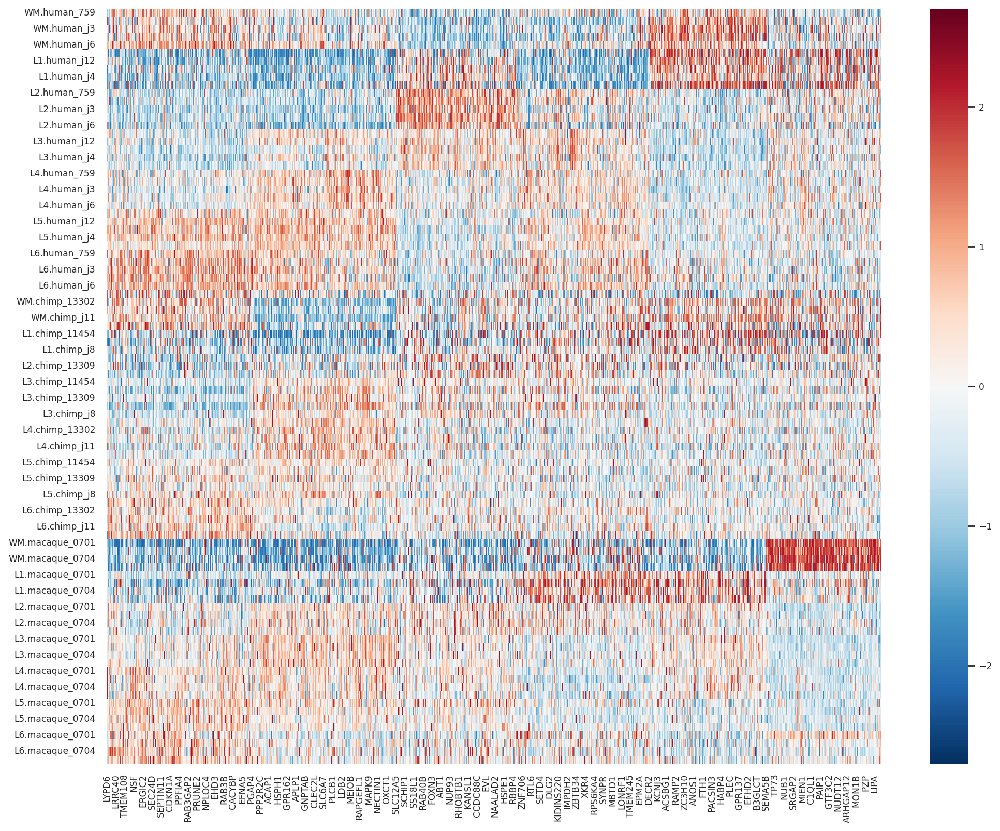

In [47]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_hs.png', bbox_inches='tight')

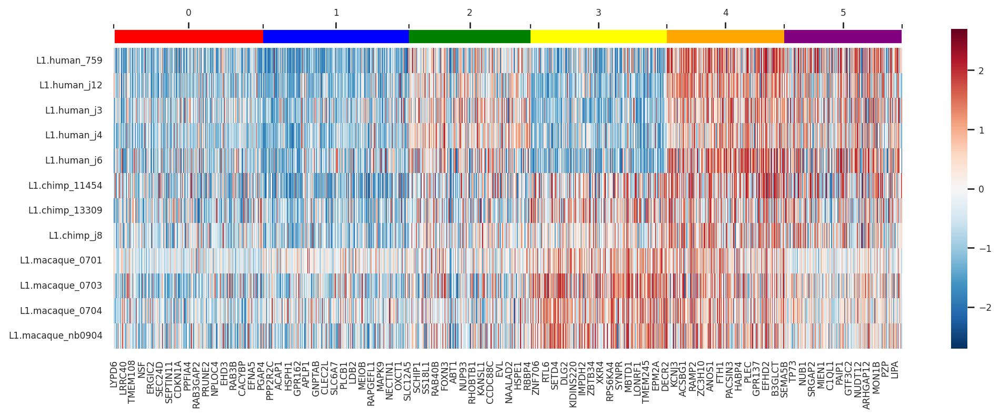

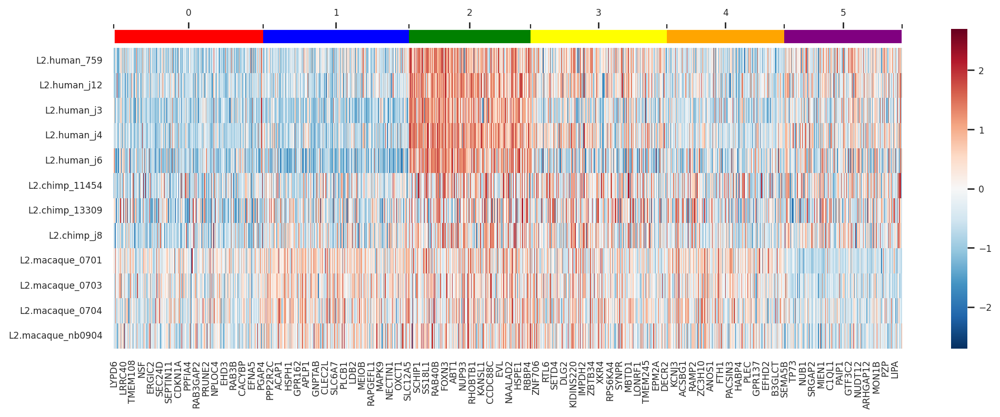

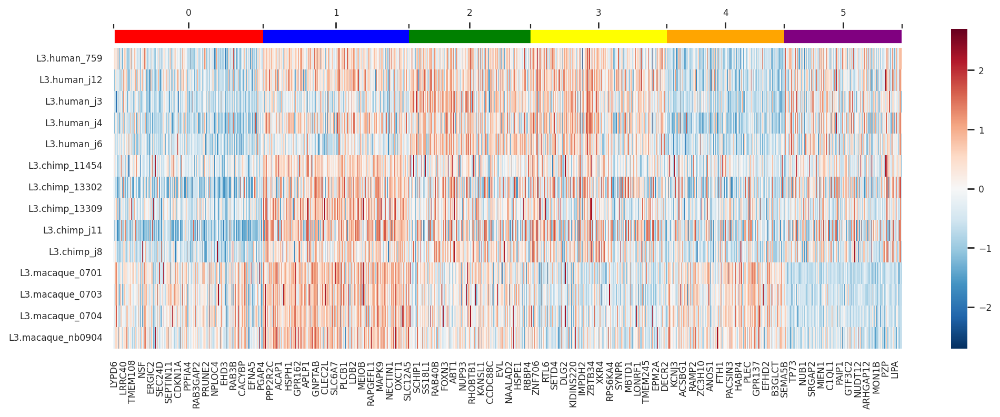

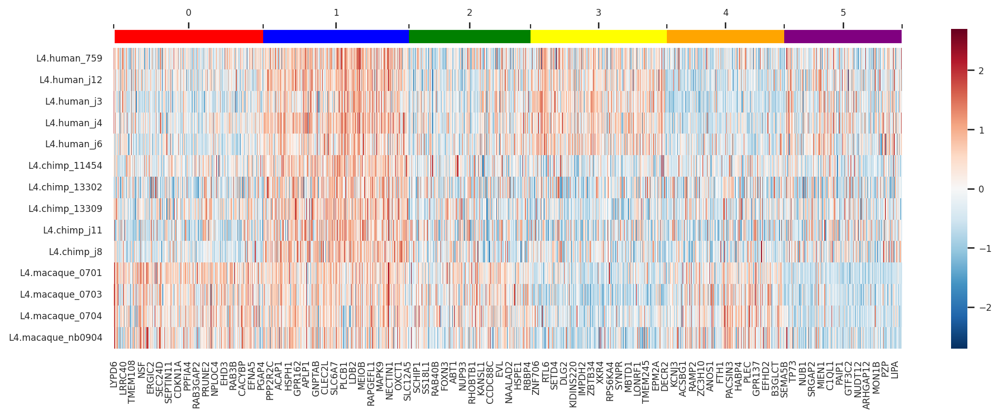

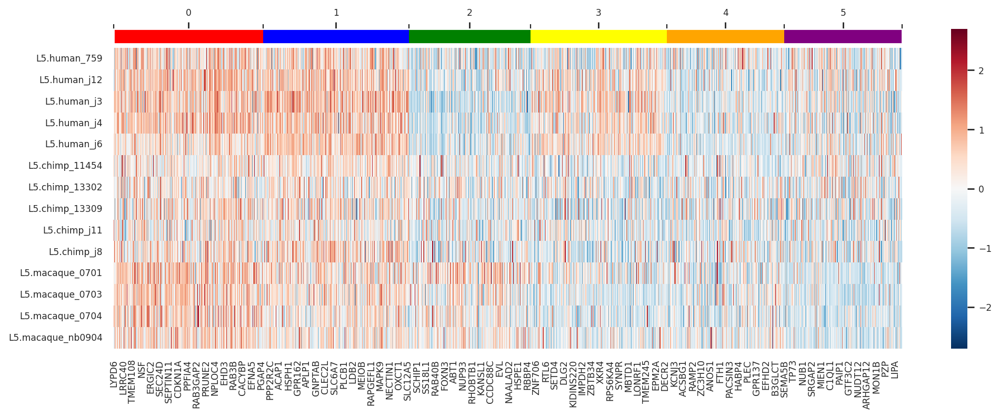

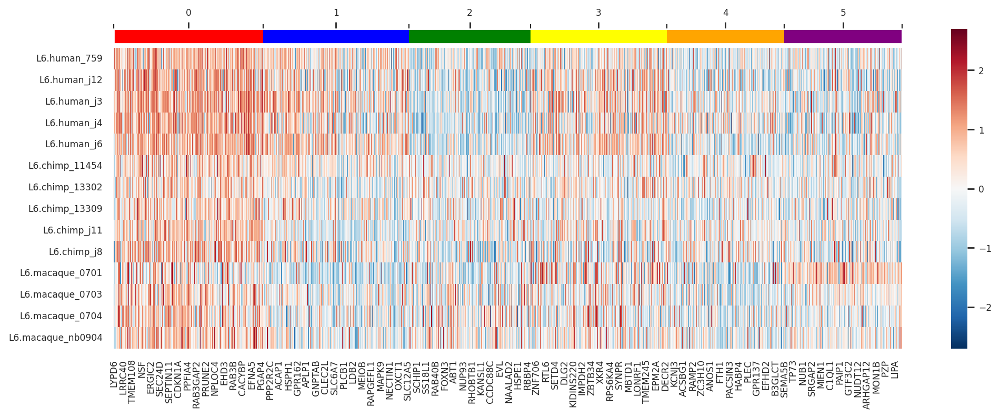

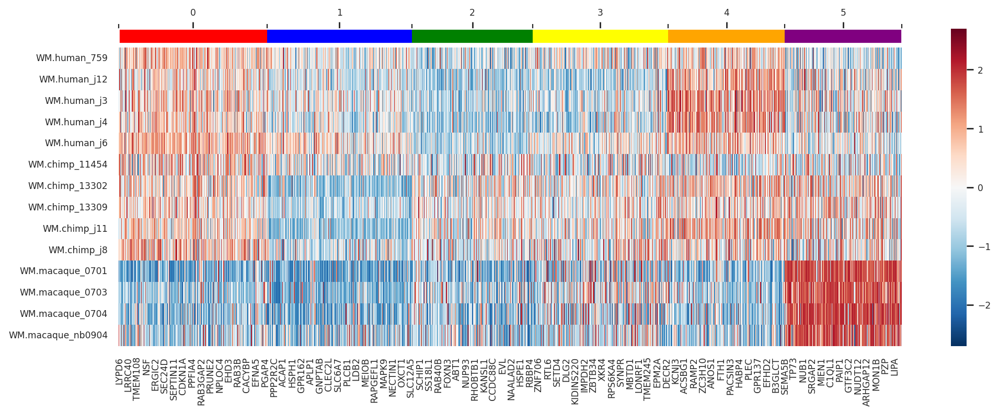

In [48]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]

for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    fig, ax = plt.subplots(figsize=(15, 5), gridspec_kw={'hspace': 0})
    df_layer = df_hs.loc[df_hs.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
    #plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova_{layer}.png', bbox_inches='tight')

### 7 кластеров

In [49]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df_hs.T, metric='cosine') + 1
n_clusters = 7
clustering = SpectralClustering(n_clusters=n_clusters, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1, n_clusters=7)

In [50]:
labels = pd.Series(clustering.labels_, index=df_hs.columns).sort_values()
order = labels.sort_values().index
labels.to_csv(de_dir_path + f'cluster_spectr_hs_{n_clusters}.csv')

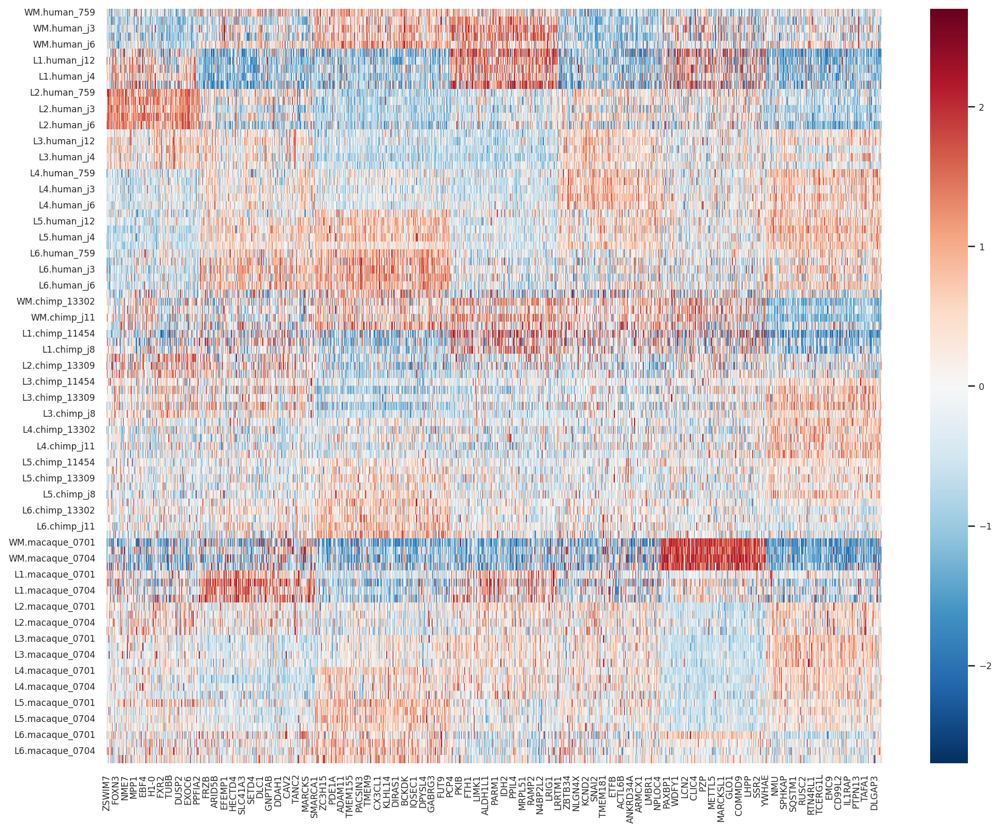

In [51]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_hs.png', bbox_inches='tight')

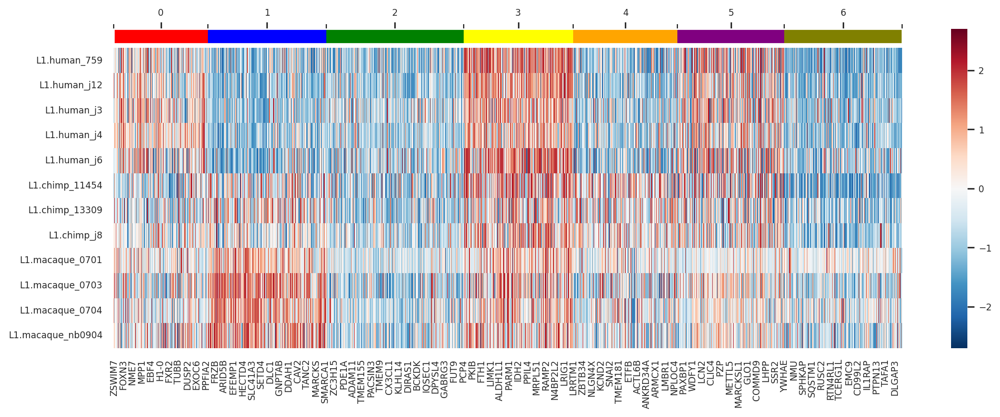

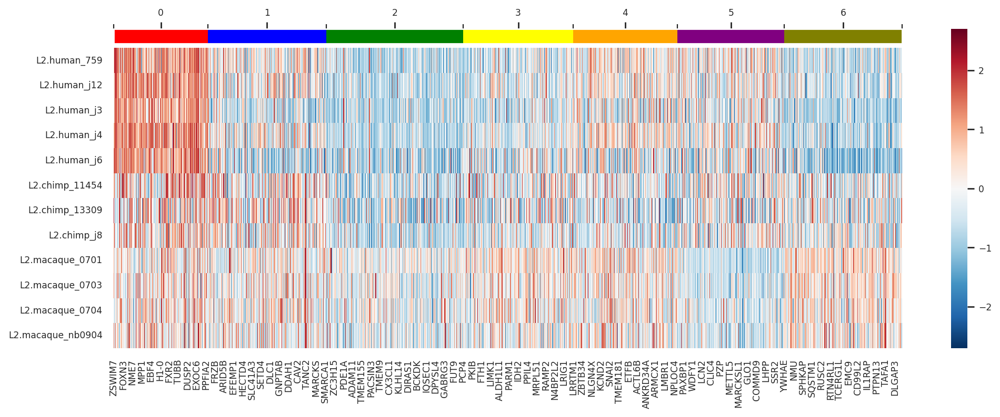

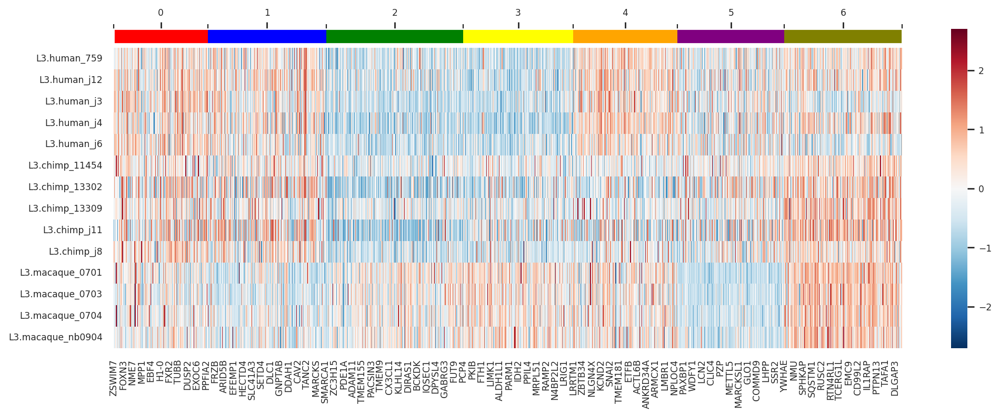

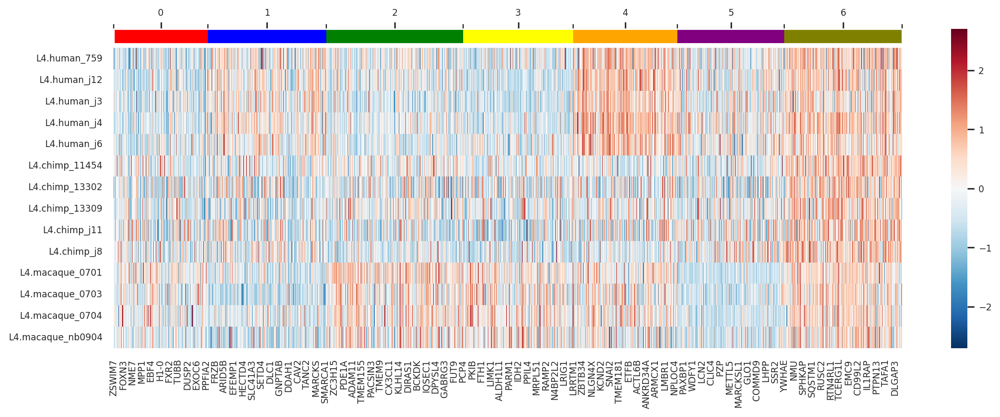

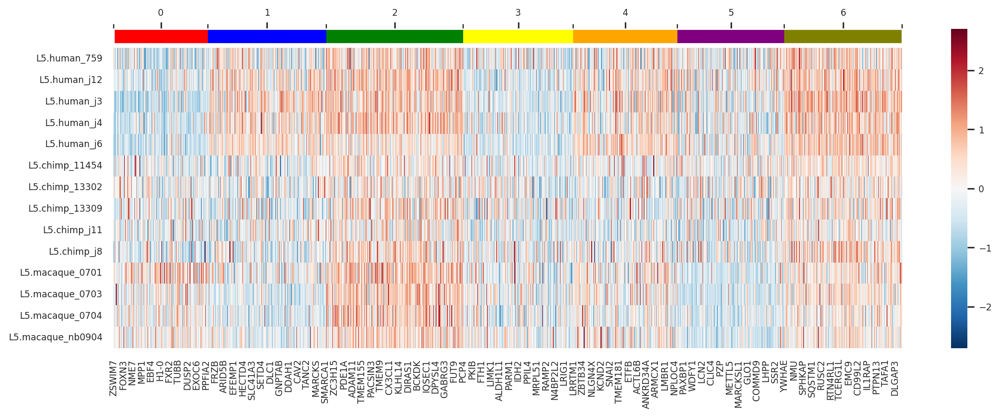

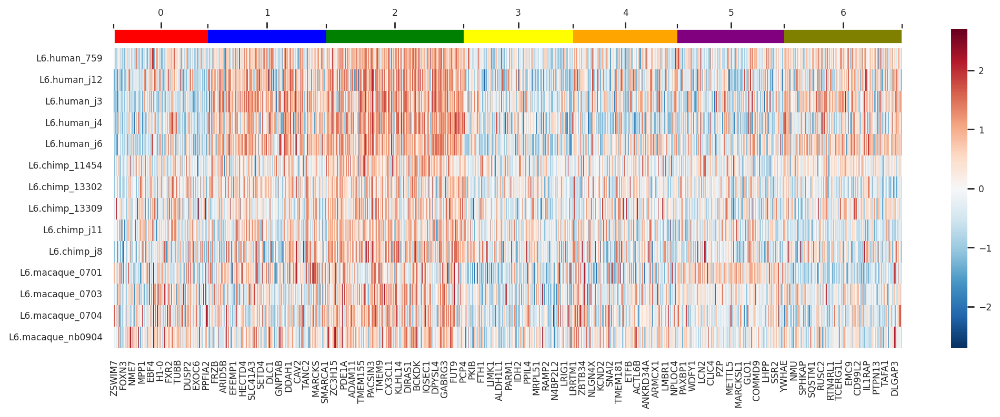

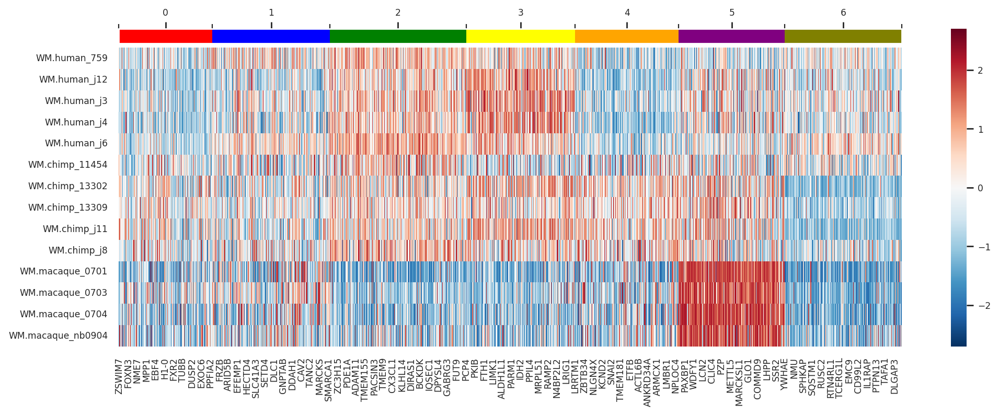

In [52]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]

for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    fig, ax = plt.subplots(figsize=(15, 5), gridspec_kw={'hspace': 0})
    df_layer = df_hs.loc[df_hs.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
    #plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova_{layer}.png', bbox_inches='tight')

### 8 кластеров

In [53]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df_hs.T, metric='cosine') + 1
n_clusters = 8
clustering = SpectralClustering(n_clusters=n_clusters, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1)

In [54]:
labels = pd.Series(clustering.labels_, index=df_hs.columns).sort_values()
order = labels.sort_values().index
labels.to_csv(de_dir_path + f'cluster_spectr_hs_{n_clusters}.csv')

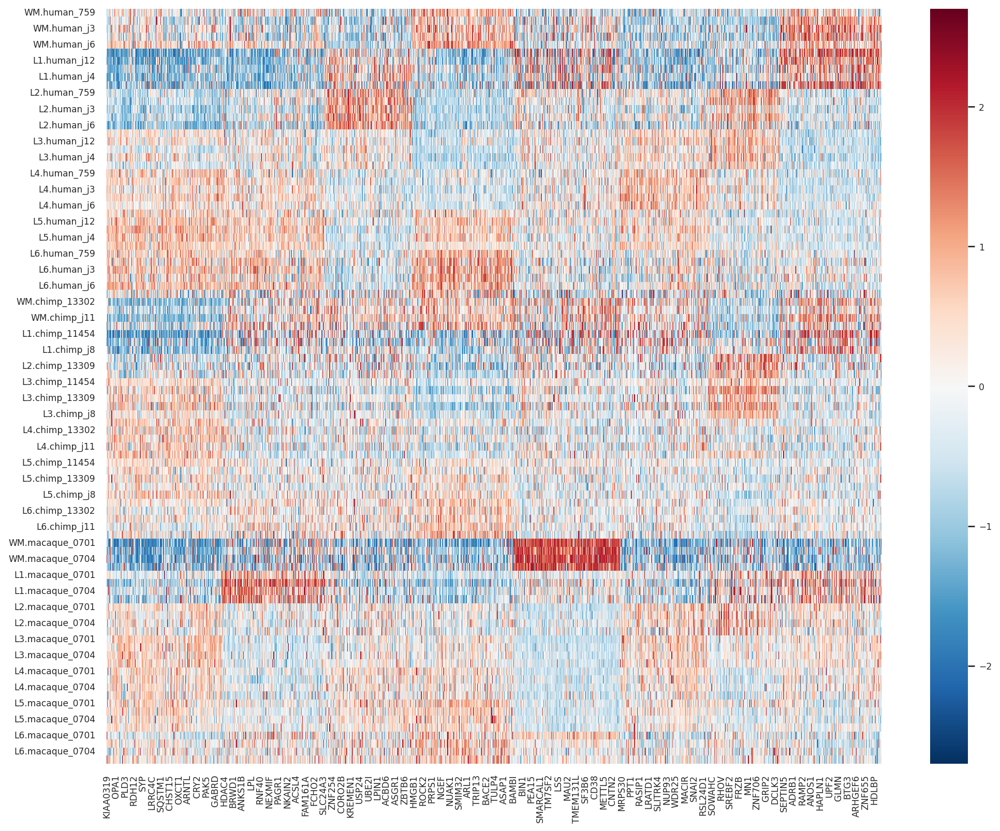

In [55]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_hs.png', bbox_inches='tight')

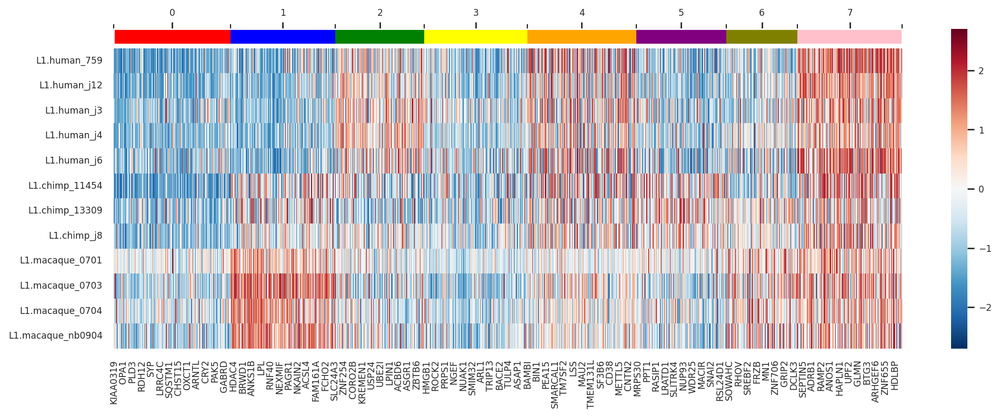

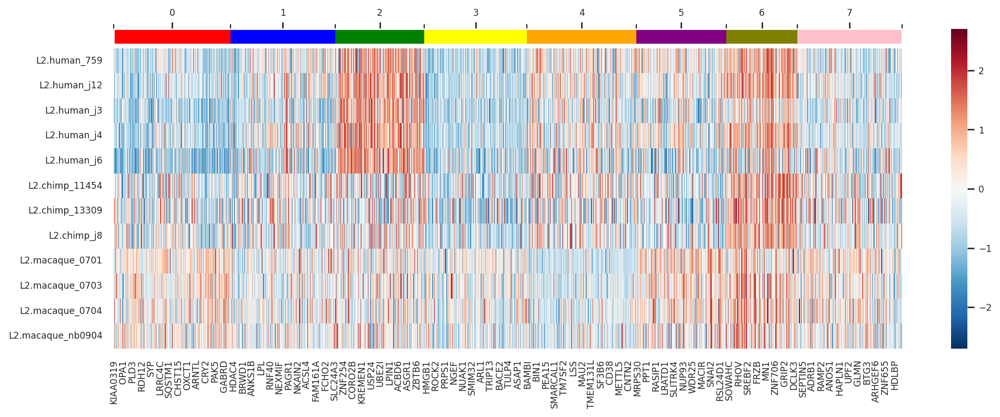

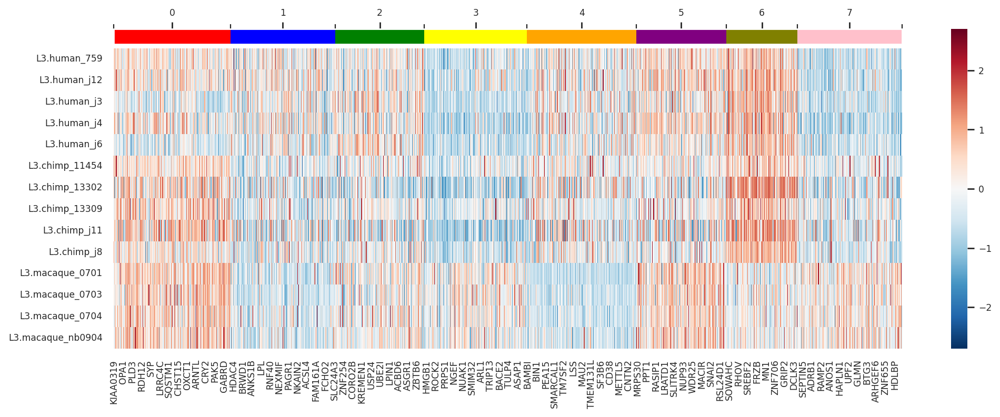

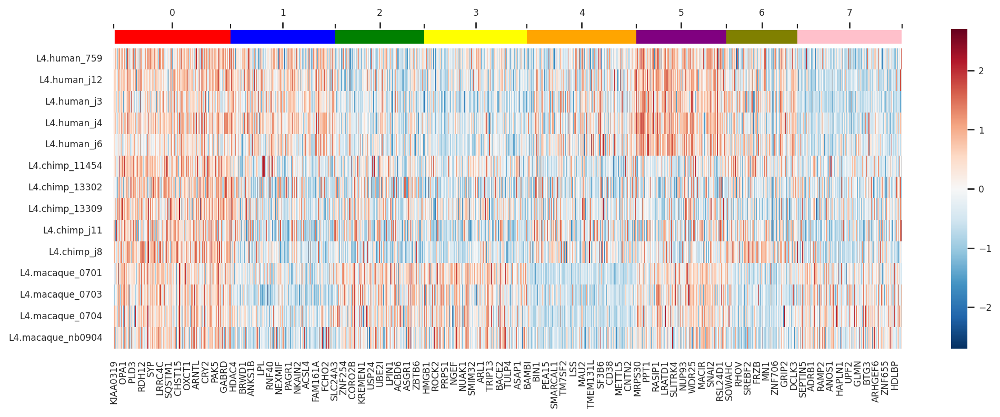

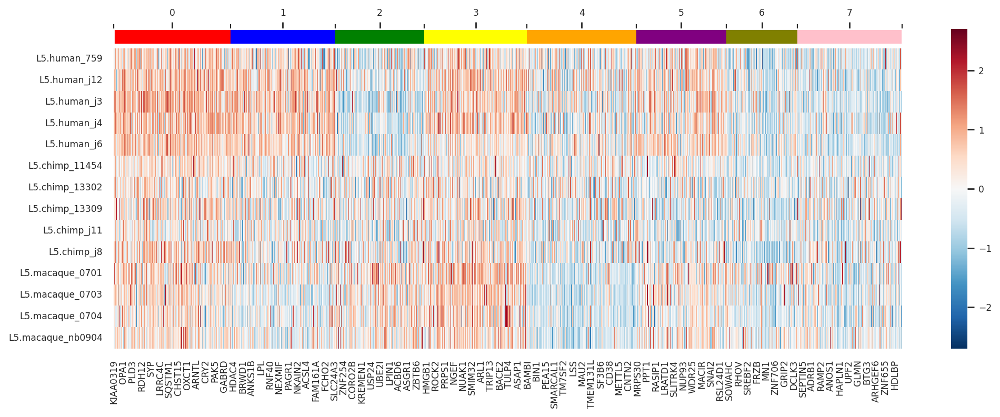

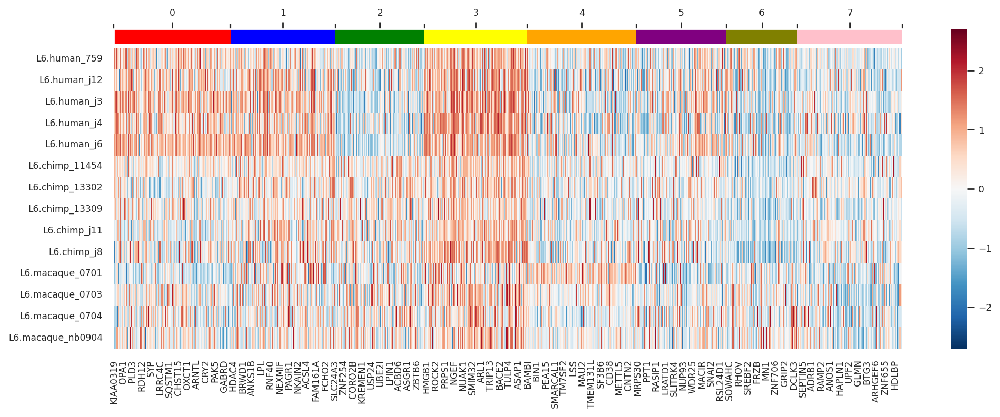

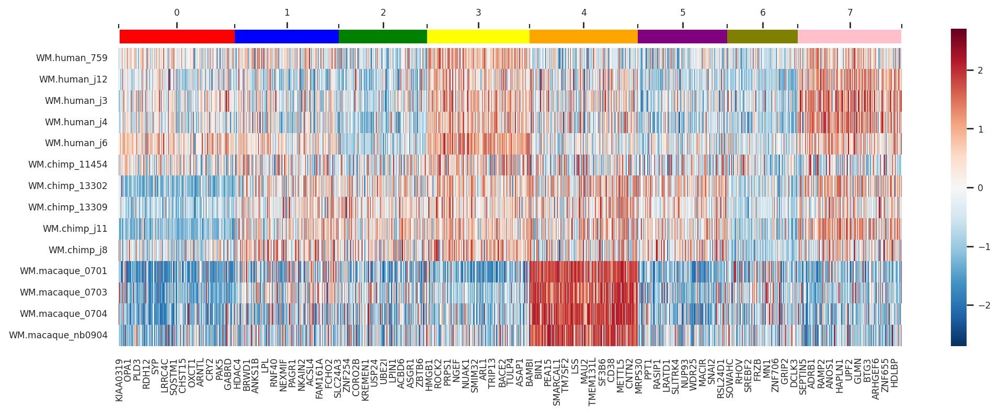

In [56]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]

for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    fig, ax = plt.subplots(figsize=(15, 5), gridspec_kw={'hspace': 0})
    df_layer = df_hs.loc[df_hs.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
    #plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova_{layer}.png', bbox_inches='tight')

### 9 кластеров

In [57]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df_hs.T, metric='cosine') + 1
n_clusters = 9
clustering = SpectralClustering(n_clusters=n_clusters, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1, n_clusters=9)

In [58]:
labels = pd.Series(clustering.labels_, index=df_hs.columns).sort_values()
order = labels.sort_values().index
labels.to_csv(de_dir_path + f'cluster_spectr_hs_{n_clusters}.csv')

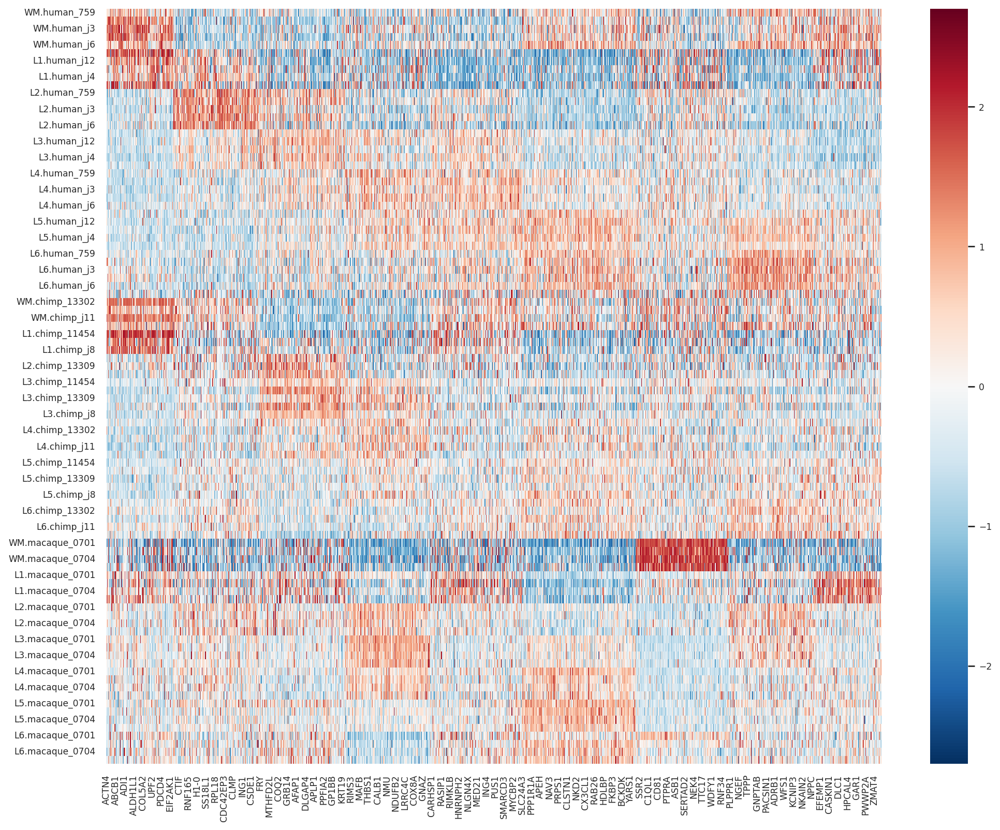

In [59]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_hs.png', bbox_inches='tight')

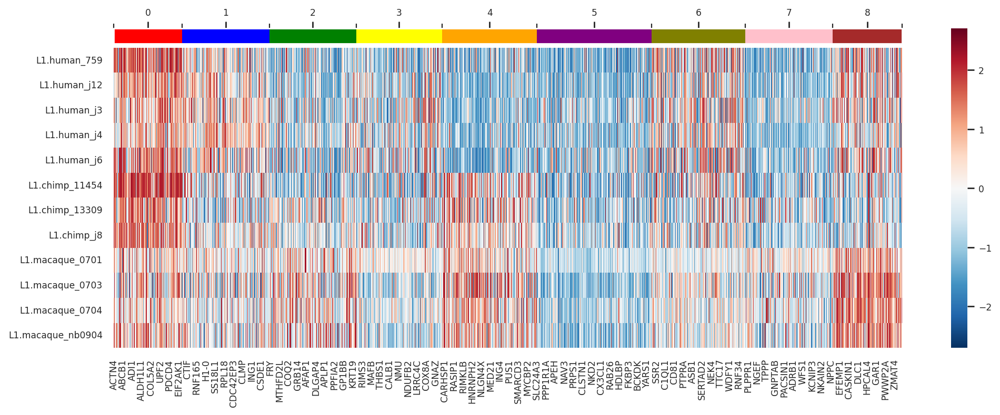

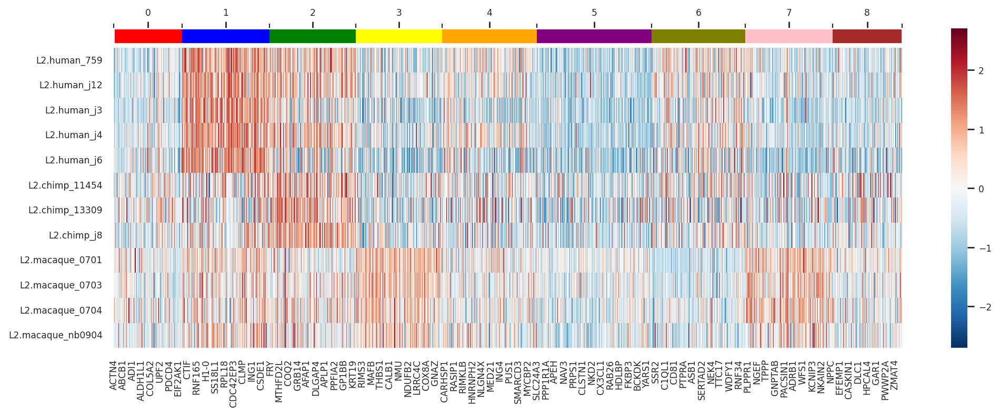

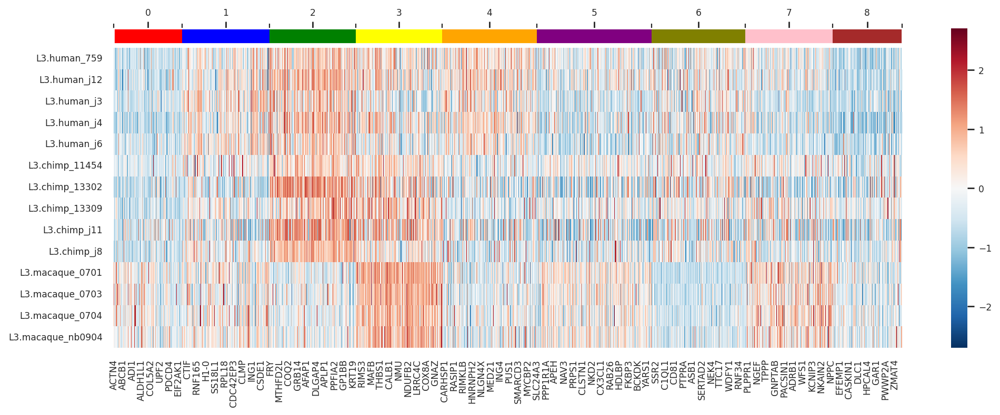

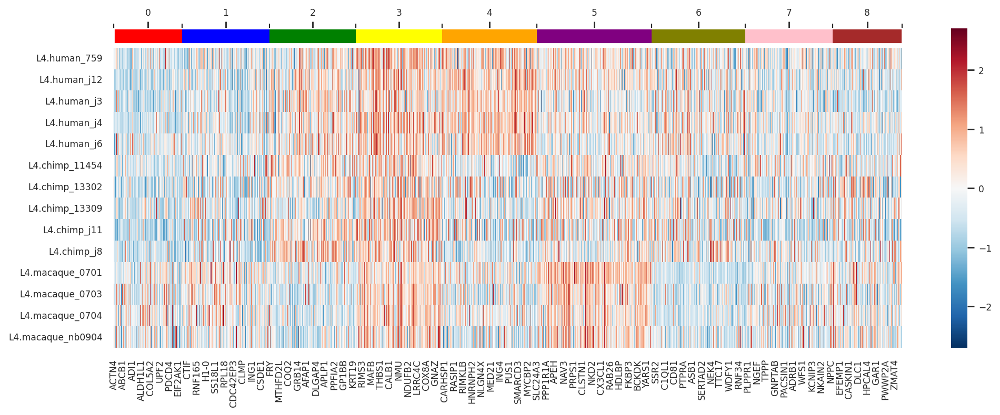

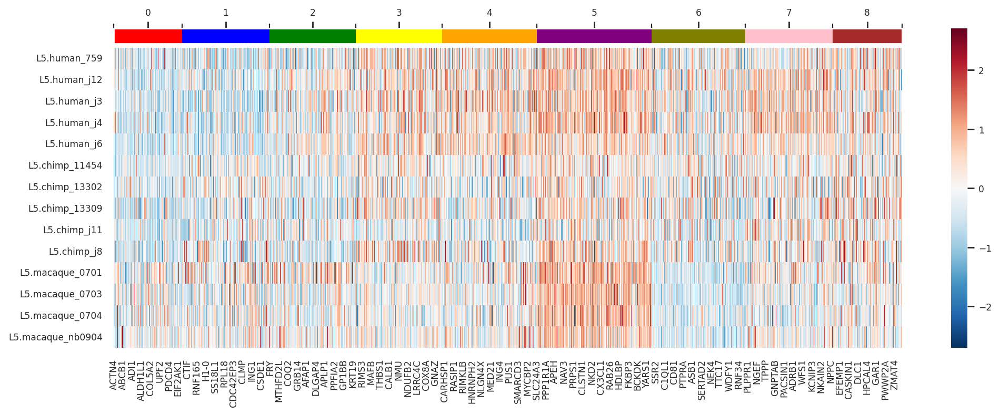

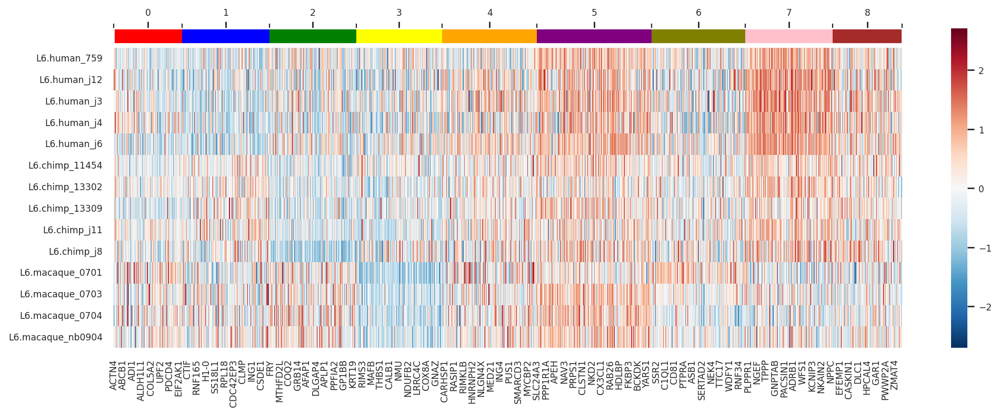

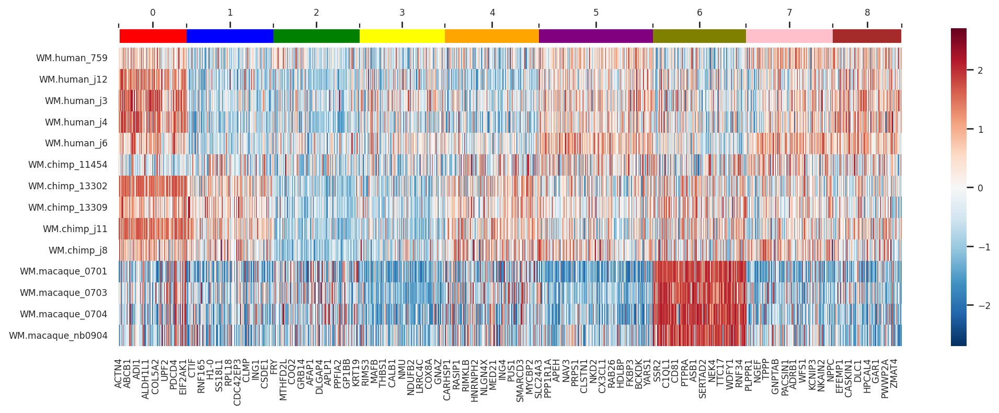

In [60]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

clusters = np.arange(n_clusters)
colors = cluster_color[:n_clusters]

for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    fig, ax = plt.subplots(figsize=(15, 5), gridspec_kw={'hspace': 0})
    df_layer = df_hs.loc[df_hs.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmax=2.7, vmin=-2.7, center=0)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(colors)

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
    #plt.savefig(f'sample_data/heatmaps/heatmap_spectr{n_clusters}_anova_{layer}.png', bbox_inches='tight')